# **LG01 - Image Based PCB Defects Detection - RISTEK FASILKOM UI DATATHON 2025**

---



Dalam industri manufaktur elektronik yang bergerak cepat, kualitas dan keandalan Printed Circuit Boards (PCB) adalah faktor krusial yang menentukan performa produk akhir. Proses produksi PCB yang kompleks seringkali menghasilkan cacat minor yang sulit terdeteksi oleh inspeksi manual, namun dapat menyebabkan kegagalan sirkuit yang signifikan. Oleh karena itu, otomatisasi proses kontrol kualitas menjadi sebuah kebutuhan mendesak untuk meningkatkan efisiensi dan konsistensi. Proyek ini menjawab tantangan tersebut dengan menerapkan pendekatan deep learning untuk deteksi cacat PCB secara otomatis.

Kami diberikan sebuah dataset visual yang kaya, berisi PCB yang telah diberi label untuk berbagai kategori cacat, termasuk 'Open_circuit', 'Short', 'Spur', dan lainnya. Menggunakan data ini, tugas kami adalah membangun sebuah model Computer Vision yang handal dan mampu mendeteksi pola cacat pada sebuah PCB. Model ini akan dilatih pada training set yang beranotasi untuk mempelajari pola visual dari setiap jenis cacat. Tujuan akhirnya adalah agar model dapat secara akurat mengidentifikasi dan melokalisasi cacat pada gambar-gambar baru dari testing set, membuktikan kelayakan implementasi sistem inspeksi cerdas di lingkungan produksi nyata.

---



# **Import Library & Dataset**

---



In [ ]:
import numpy as np
import pandas as pd
import matplotlib.pyplot as plt
from matplotlib import patches
import seaborn as sns
import os
import random
import re
import shutil
import torch
import torch.nn as nn
import torch.optim as optim
from torch.utils.data import DataLoader, Dataset
from torchvision import models, transforms, utils
from PIL import Image
from sklearn.model_selection import train_test_split
from sklearn.metrics import confusion_matrix, classification_report
import time
import copy
import warnings
warnings.filterwarnings('ignore')

In [ ]:
import kagglehub
akhatova_pcb_defects_path = kagglehub.dataset_download('akhatova/pcb-defects')

100%|██████████| 1.88G/1.88G [00:18<00:00, 108MB/s]

Extracting files...


In [ ]:
akhatova_pcb_defects_path = kagglehub.dataset_download('akhatova/pcb-defects')

In [ ]:
input_dir='/kaggle/input/pcb-defects/PCB_DATASET'
os.listdir(input_dir)

['rotate.py', 'PCB_USED', 'Annotations', 'images', 'rotation']

# **Exploratory Data Analysis**

---



# Penjelasan Isi Setiap Folder

---


## PCB USED folder
Folder PCB USED adalah tempat untuk menyimpan 12 gambar template PCB yang menjadi referensi utama dalam seluruh dataset. Gambar-gambar ini penting karena berperan sebagai dasar untuk berbagai operasi fundamental dalam proyek. Misalnya, mereka sering digunakan dalam pencocokan pola (pattern matching), membantu menyelaraskan dan menstandarisasi orientasi serta skala gambar PCB yang akan diinspeksi. Ini memastikan bahwa semua gambar memiliki properti spasial yang konsisten sebelum analisis lebih lanjut. Selain itu, template ini juga berfungsi untuk normalisasi citra, yang sangat penting untuk mencapai akurasi tinggi dalam deteksi. Yang tak kalah penting, gambar-gambar ini menyediakan "pola normal" dari PCB yang tanpa cacat, memungkinkan algoritma untuk secara efektif mengidentifikasi area-area yang menyimpang secara signifikan, yang merupakan indikasi adanya cacat.


## Images folder
Folder images merupakan repositori utama untuk semua gambar PCB mentah yang akan menjadi objek analisis. Gambar-gambar ini disubkelas atau dikelompokkan ke dalam berbagai jenis atau kategori, yang bisa berdasarkan pada jenis cacat yang teridentifikasi (misalnya, short circuit, open circuit, mouse bite), kondisi PCB (seperti good PCB untuk gambar tanpa cacat dan defective PCB untuk yang memiliki cacat), atau bahkan tahap produksi jika data mencakup PCB dari berbagai tahapan manufaktur. Setiap gambar di dalam folder ini berfungsi sebagai input mentah yang akan diproses dan diinterpretasikan oleh model deteksi cacat yang Anda kembangkan.

## Annotations Folder
Isinya adalah informasi detail tentang di mana letak cacat pada setiap gambar, dan cacat jenis apa itu. Saya membayangkannya seperti saya punya sebuah foto PCB, lalu saya menggambar kotak di sekeliling setiap cacat yang ada di foto itu. Data ini biasanya berupa daftar koordinat (seperti x, y, lebar, tinggi) yang menunjukkan posisi dan ukuran kotak cacat, dan juga nama jenis cacatnya . Setiap kali ada gambar PCB yang punya cacat, di folder ini akan ada file pasangannya yang menjelaskan: "Di gambar ini, ada cacat jenis A di lokasi ini, dan cacat jenis B di lokasi itu."

## Rotation Folder
Folder rotation untuk menyimpan gambar-gambar PCB yang telah mengalami transformasi rotasi. Sama seperti folder images, gambar di sini juga disubkelas berdasarkan jenisnya, dan yang terpenting, folder ini menyertakan informasi mengenai sudut rotasinya. Tujuan utama dari folder ini adalah untuk memfasilitasi augmentasi data (data augmentation), sebuah teknik vital yang digunakan untuk memperkaya variasi dalam dataset pelatihan. Dengan melatih model menggunakan gambar yang telah dirotasi, kita secara signifikan meningkatkan robustness model terhadap variasi orientasi di dunia nyata. Ini berarti model akan lebih mampu mengenali cacat meskipun PCB tidak berada dalam orientasi yang sempurna saat diinspeksi.

In [ ]:
item = os.listdir(input_dir)
for item_names in item:
    path_lengkap_item = os.path.join(input_dir, item_names)

    if os.path.isdir(path_lengkap_item):
        print(f"Folder: {path_lengkap_item}")
        try:
            isi_subfolder=os.listdir(path_lengkap_item)
            if not isi_subfolder:
                print("  -> Empty Folder")
            else:
                for nama_file in isi_subfolder[:5]:
                    print(f"  - {nama_file}")
                if len(isi_subfolder) > 5:
                    print(f"And many more...")
        except Exception as e:
            print(f"  -> File not found {e}")
        print("-" * 20)

Folder: /kaggle/input/pcb-defects/PCB_DATASET/PCB_USED
  - 10.JPG
  - 01.JPG
  - 09.JPG
  - 05.JPG
  - 06.JPG
And many more...
--------------------
Folder: /kaggle/input/pcb-defects/PCB_DATASET/Annotations
  - Mouse_bite
  - Spur
  - Open_circuit
  - Short
  - Missing_hole
And many more...
--------------------
Folder: /kaggle/input/pcb-defects/PCB_DATASET/images
  - Mouse_bite
  - Spur
  - Open_circuit
  - Short
  - Missing_hole
And many more...
--------------------
Folder: /kaggle/input/pcb-defects/PCB_DATASET/rotation
  - Missing_hole_rotation
  - Spur_rotation
  - Mouse_bite_angles.txt
  - Missing_hole_angles.txt
  - Open_circuit_rotation
And many more...
--------------------


In [ ]:
template_dir=os.path.join(input_dir,'PCB_USED')
template_dir

'/kaggle/input/pcb-defects/PCB_DATASET/PCB_USED'

In [ ]:
import math
def imageVisualize(dir_path, num_to_show=4, random_sample=False, figsize=(16, 8)):
    all_files = os.listdir(dir_path)
    image_files = [f for f in all_files if f.lower().endswith(('.png', '.jpg', '.jpeg', '.gif', '.bmp'))]
    if not image_files:
        print("tidak ada file ditemukan")
        return
    if random_sample:
        num_to_show = min(num_to_show, len(image_files))
        selected_files = random.sample(image_files, num_to_show)
    else:
        image_files.sort()
        num_to_show = min(num_to_show, len(image_files))
        selected_files = image_files[:num_to_show]
    num_cols = 4
    num_rows = math.ceil(len(selected_files) / num_cols)
    fig, axes = plt.subplots(num_rows, num_cols, figsize=figsize)
    axes = axes.flatten()
    for i, filename in enumerate(selected_files):
        img_path = os.path.join(dir_path, filename)
        img = plt.imread(img_path)
        ax = axes[i]
        ax.imshow(img)
        title = f"{filename[:20]}..." if len(filename) > 20 else filename
        ax.set_title(f"{title}\nShape: {img.shape}", fontsize=10)

        ax.axis('off')

    for i in range(len(selected_files), len(axes)):
        axes[i].axis('off')
    plt.suptitle(f'Visualisasi {len(selected_files)} Gambar dari Folder: {os.path.basename(dir_path)}', fontsize=16)
    plt.tight_layout(rect=[0, 0.03, 1, 0.95])
    plt.show()

## Menganalisa Folder Image

---



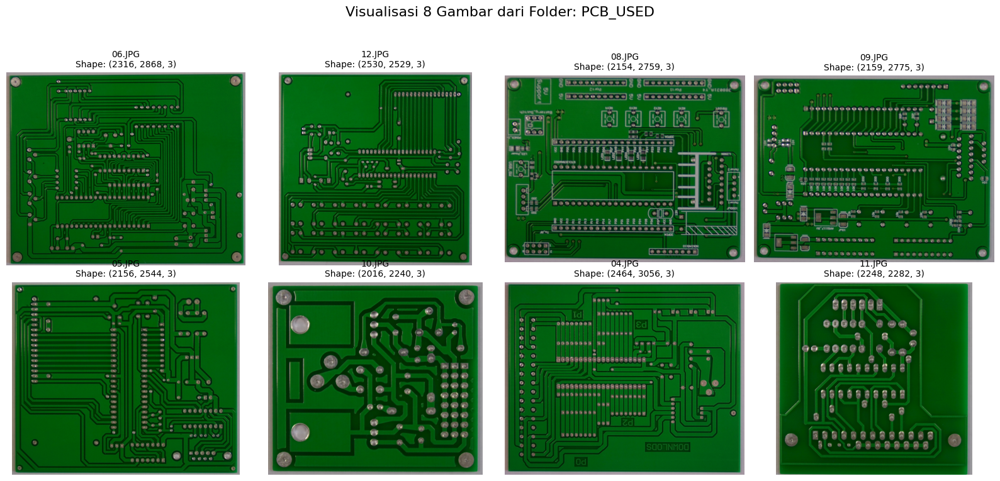

In [ ]:
imageVisualize(template_dir, num_to_show=8, random_sample=True)

## Tipe *defects* yang ada pada dataset

---



In [ ]:
img_dir=os.path.join(input_dir,'images')
os.listdir(img_dir)
types_defect=os.listdir(os.path.join(input_dir,'images'))
types_defect

['Mouse_bite',
 'Spur',
 'Open_circuit',
 'Short',
 'Missing_hole',
 'Spurious_copper']

1. Mouse Bite
-Deskripsi: Cacat ini muncul sebagai gerusan atau lekukan acak berbentuk setengah lingkaran pada tepi jalur tembaga (trace). Sesuai namanya, bentuknya menyerupai bekas gigitan tikus.

-Potensi Dampak: Mengurangi lebar konduktor pada titik tersebut. Hal ini dapat mengubah impedansi jalur, meningkatkan resistansi, dan pada kasus yang parah, membuatnya rentan putus akibat panas atau tekanan fisik.

-Tantangan Deteksi: Ukurannya bisa sangat bervariasi, dari lekukan kecil yang sulit dilihat hingga gerusan besar yang jelas. Model harus bisa membedakannya dari desain PCB yang memang memiliki sudut atau lekukan.


2. Spur
-Deskripsi: Spur adalah tonjolan kecil atau "duri" tembaga yang tidak diinginkan yang menonjol keluar dari jalur konduktif.

-Potensi Dampak: Meskipun kecil, spur dapat mengurangi jarak isolasi antar jalur. Jika cukup panjang, ia berpotensi menyebabkan korsleting (short circuit) dengan jalur atau komponen di dekatnya, terutama pada lingkungan yang lembab.

-Tantangan Deteksi: Cacat ini seringkali berukuran sangat kecil (mikroskopis), sehingga memerlukan resolusi gambar yang tinggi dan model yang sensitif untuk dapat dideteksi secara akurat.



3. Open Circuit
-Deskripsi: Sebuah cacat di mana terdapat celah atau putusnya jalur konduktif yang seharusnya tersambung. Ini adalah salah satu cacat paling kritis.

-Potensi Dampak: Secara langsung menyebabkan kegagalan fungsional total pada bagian sirkuit tersebut karena arus listrik tidak dapat mengalir.

-Tantangan Deteksi: Celah bisa sangat tipis seperti sehelai rambut, sehingga sulit dibedakan dari goresan atau noise pada gambar.



4. Short (Short Circuit)
-Deskripsi: Kebalikan dari Open Circuit, Short adalah terbentuknya koneksi tembaga yang tidak diinginkan di antara dua jalur atau lebih yang seharusnya terisolasi.

-Potensi Dampak: Menyebabkan korsleting, mengalihkan arus listrik ke jalur yang salah. Ini dapat merusak komponen sensitif secara permanen dan bahkan menimbulkan risiko kebakaran.

-Tantangan Deteksi: Jembatan tembaga yang menyebabkan korsleting bisa sangat tipis dan tidak beraturan bentuknya.



5. Missing Hole
-Deskripsi: Cacat ini terjadi ketika sebuah lubang yang seharusnya ada pada PCB (baik untuk via—koneksi antar lapisan—maupun untuk pemasangan komponen) tidak dibuat saat proses pengeboran.

-Potensi Dampak: Menghalangi pemasangan komponen through-hole atau memutus konektivitas antar lapisan PCB, yang pada dasarnya merusak desain sirkuit yang telah dirancang.

-Tantangan Deteksi: Model harus memiliki referensi atau pemahaman tentang desain asli (pola lubang yang benar) untuk bisa mengidentifikasi ketiadaan sebuah lubang.



6. Spurious Copper
-Deskripsi: Adanya bercak atau pulau tembaga sisa di area PCB yang seharusnya bersih (area isolasi). Tembaga ini tidak terhubung ke sirkuit manapun.

-Potensi Dampak: Serupa dengan Spur, Spurious Copper mengurangi jarak isolasi dan dapat menyebabkan korsleting jika berada di antara dua titik bertegangan. Ia juga bisa terlepas dan bergerak, menyebabkan korsleting intermiten yang sulit dilacak.

-Tantangan Deteksi: Bentuk dan ukurannya sangat acak, sehingga model harus belajar untuk mengenali "objek" yang tidak seharusnya ada di area kosong.

In [ ]:
img_path_list=[]
for sub_cat in types_defect:
    for file in os.listdir(os.path.join(img_dir,sub_cat)):
        img_path_list.append(os.path.join(img_dir,sub_cat,file))

### Beberapa gambaran bentuk PCB yang disertai kerusakan serta jenisnya

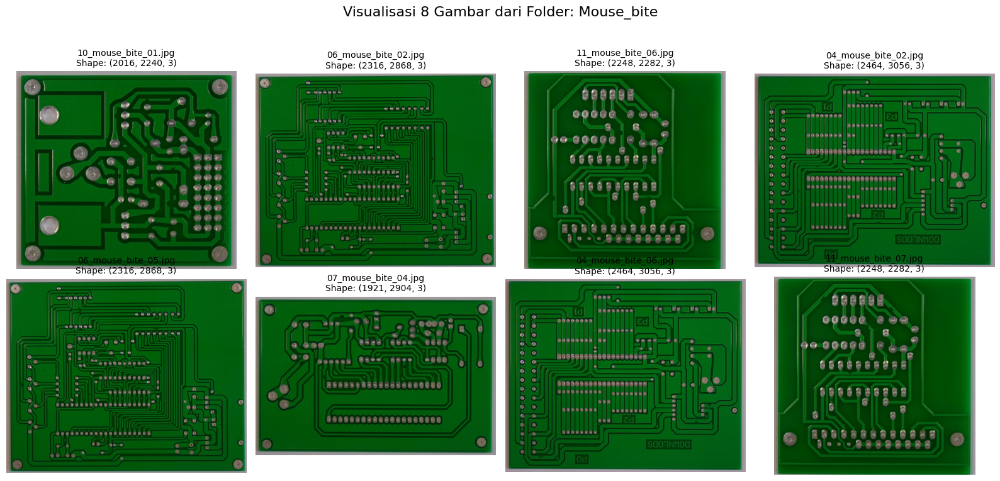

No of Mouse_bite images:115


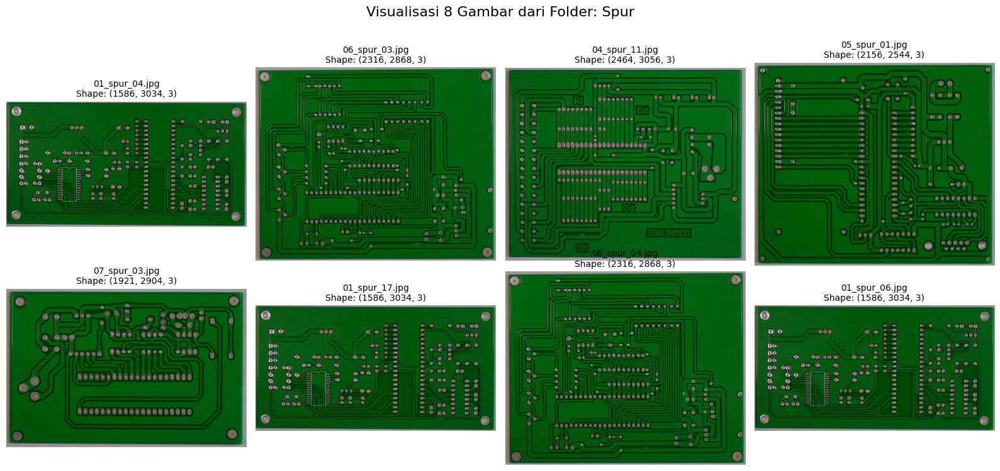

No of Spur images:115


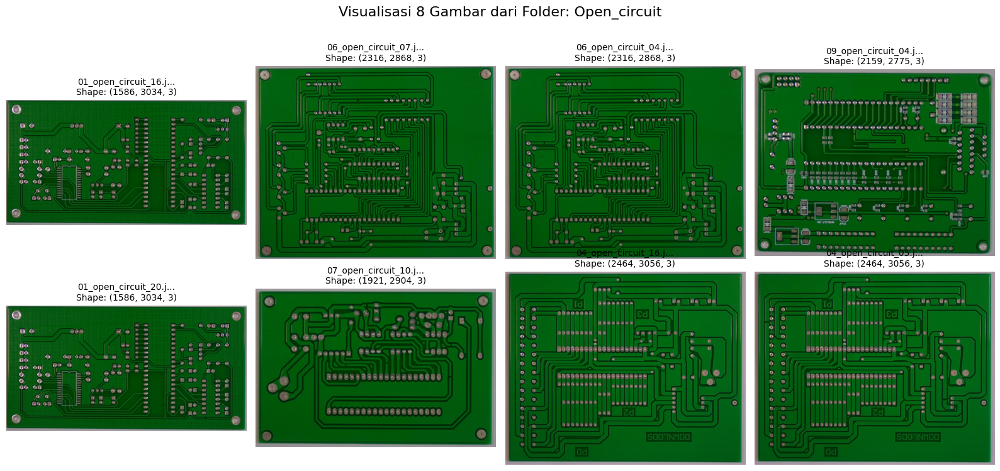

No of Open_circuit images:116


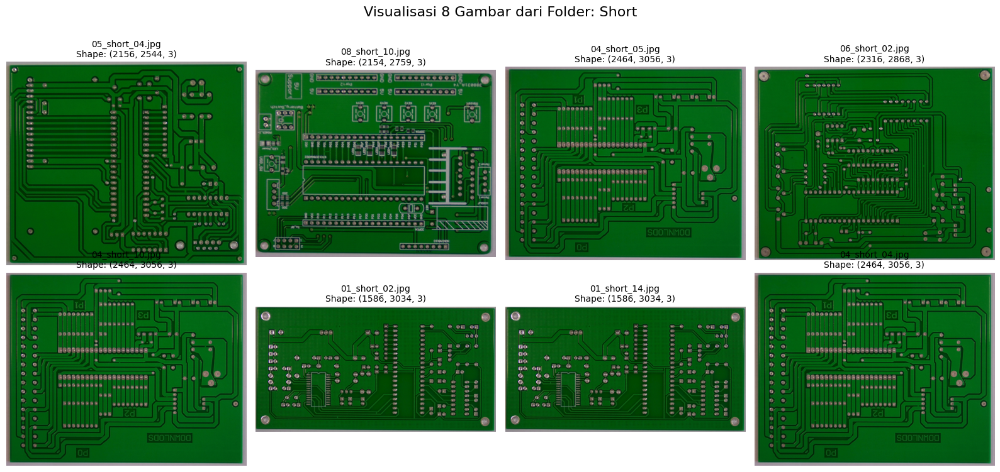

No of Short images:116


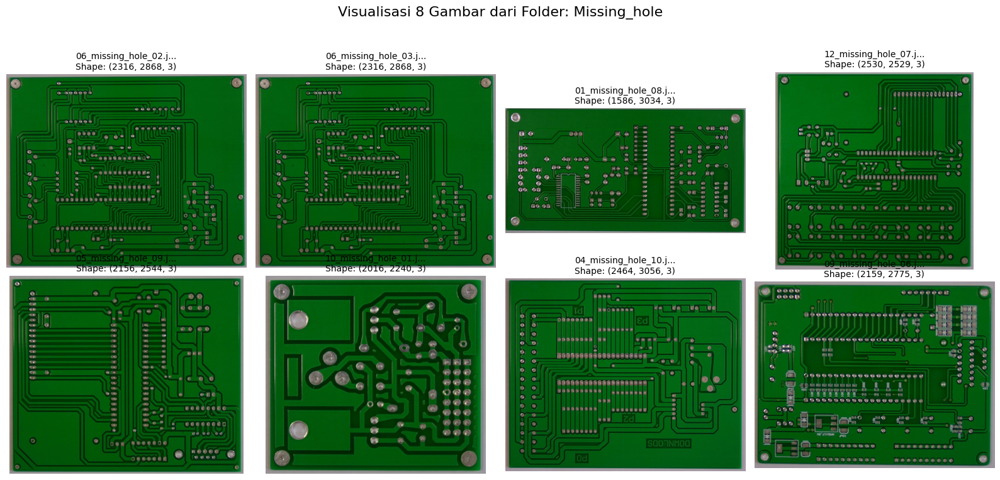

No of Missing_hole images:115


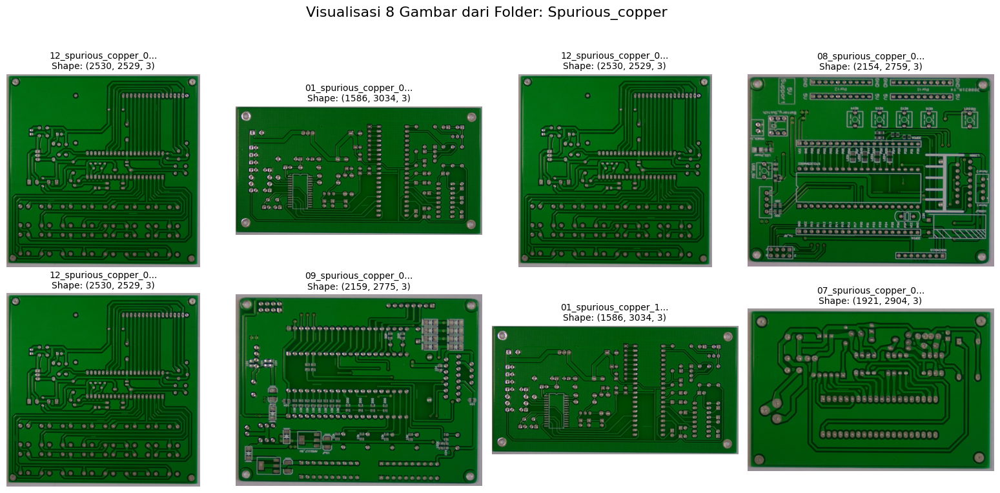

No of Spurious_copper images:116


In [ ]:
df_defect=pd.DataFrame(columns=['No of defect'])
for sub_cat in types_defect:
    imageVisualize(os.path.join(img_dir,sub_cat), num_to_show=8, random_sample=True)
    print(f'No of {sub_cat} images:{len(os.listdir(os.path.join(img_dir,sub_cat)))}')
    df_defect.loc[sub_cat]=len(os.listdir(os.path.join(img_dir,sub_cat)))


Dataset yang digunakan dalam proyek ini terdiri dari kumpulan gambar digital beresolusi tinggi dari Printed Circuit Boards (PCB) yang telah melalui proses anotasi secara cermat. Setiap gambar dalam dataset ini telah diidentifikasi dan diberi label untuk menandai adanya anomali atau cacat produksi. Terdapat enam kategori cacat yang menjadi fokus utama, yaitu Mouse_bite, Spur, Open_circuit, Short, Missing_hole, dan Spurious_copper. Secara fundamental, data ini memiliki karakteristik yang sangat menguntungkan karena distribusinya sangat seimbang, dengan setiap kategori cacat memiliki jumlah sampel yang hampir setara, yakni antara 115 hingga 116 data. Kondisi ideal ini memastikan bahwa model machine learning yang akan dikembangkan dapat mempelajari fitur dari setiap jenis cacat secara adil tanpa risiko bias terhadap kelas tertentu, sehingga menjadi fondasi yang solid untuk membangun sistem deteksi yang andal.

In [ ]:
df_defect

,No of defect
Mouse_bite,115
Spur,115
Open_circuit,116
Short,116
Missing_hole,115
Spurious_copper,116


## Menganalisa Folder Rotation

---



In [ ]:
rotated_dir=os.path.join(input_dir,'rotation')
os.listdir(rotated_dir)

['Missing_hole_rotation',
 'Spur_rotation',
 'Mouse_bite_angles.txt',
 'Missing_hole_angles.txt',
 'Open_circuit_rotation',
 'Spurious_copper_angles.txt',
 'Spur_angles.txt',
 'Short_angles.txt',
 'Short_rotation',
 'Spurious_copper_rotation',
 'Open_circuit_angles.txt',
 'Mouse_bite_rotation']

### Hal yang dapat ditemukan:
Pada folder Rotation ditemukan 5 jenis cacat (Missing_hole, Spur, Mouse_bite, Open_circuit, Short, Spurious_copper) yang masing-masing memiliki folder berisi gambar hasil rotasi (*_rotation) dan file berisi daftar sudut rotasi (*_angles.txt). Ini menunjukkan dataset telah menyediakan data augmentasi rotasi yang kaya dan sangat membantu.

---



### Ketersediaan Augmentasi Rotasi yang Lengkap
- Dataset ini secara eksplisit menyediakan gambar-gambar PCB yang sudah dirotasi beserta sudut rotasinya untuk berbagai jenis cacat. Ini adalah aset berharga yang sangat penting.

### Implikasi untuk Model Robustness
- Adanya data ini memungkinkan untuk langsung melatih model agar sangat tahan terhadap perubahan orientasi PCB. Tidak perlu membuat data rotasi dari nol, yang menghemat waktu dan sumber daya komputasi. Model akan lebih akurat dalam mendeteksi cacat di berbagai kondisi nyata.

In [ ]:
rotated_angle_list=[j for j in os.listdir(rotated_dir) if j.endswith('.txt')]
rotated_angle_list

['Mouse_bite_angles.txt',
 'Missing_hole_angles.txt',
 'Spurious_copper_angles.txt',
 'Spur_angles.txt',
 'Short_angles.txt',
 'Open_circuit_angles.txt']

In [ ]:
types_defect_rotated=[j for j in os.listdir(rotated_dir) if j.endswith('.txt')==False]
types_defect_rotated

['Missing_hole_rotation',
 'Spur_rotation',
 'Open_circuit_rotation',
 'Short_rotation',
 'Spurious_copper_rotation',
 'Mouse_bite_rotation']

### Visualisasi Gambar PCB yang terrotasi


---



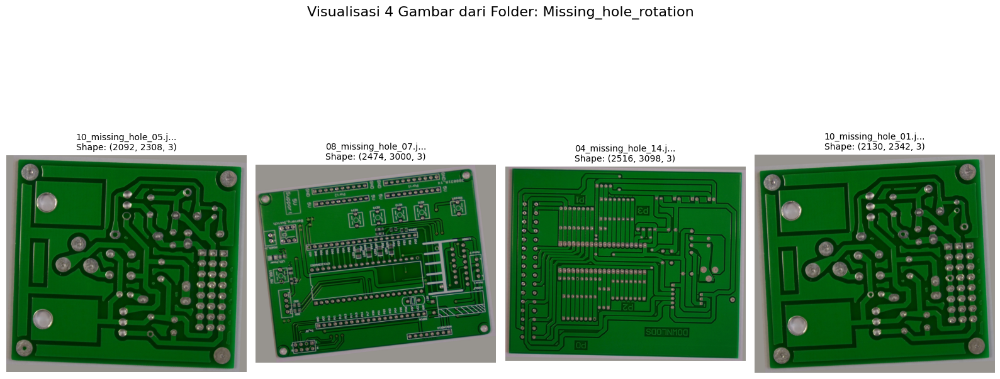

No of Missing_hole_rotation images:115


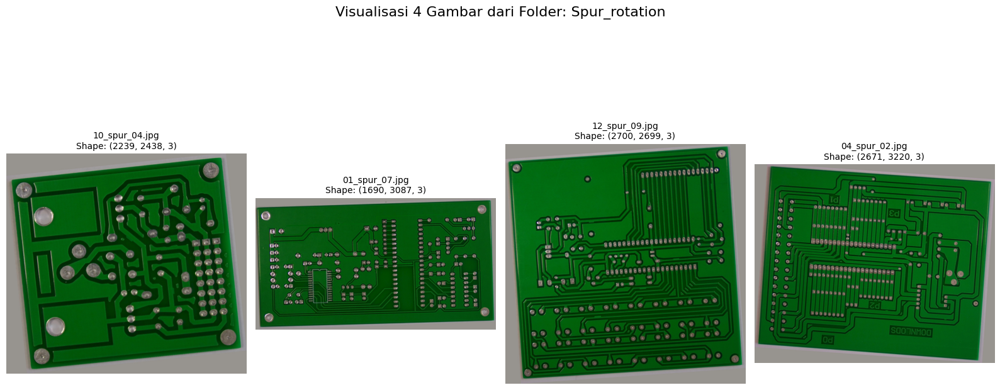

No of Spur_rotation images:115


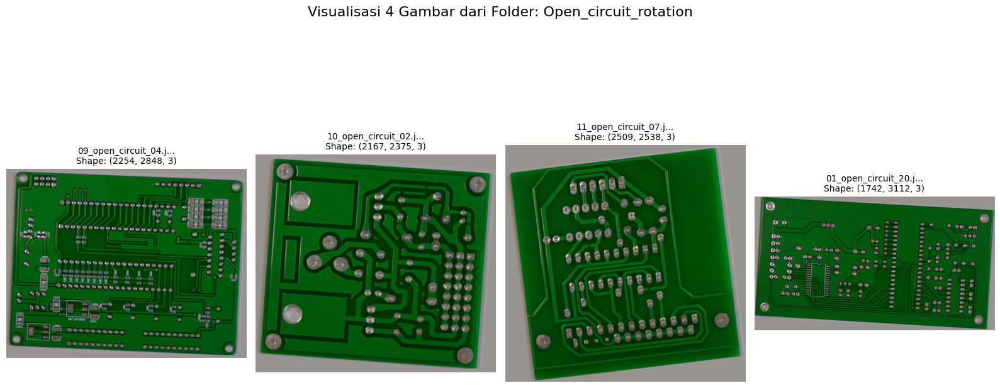

No of Open_circuit_rotation images:116


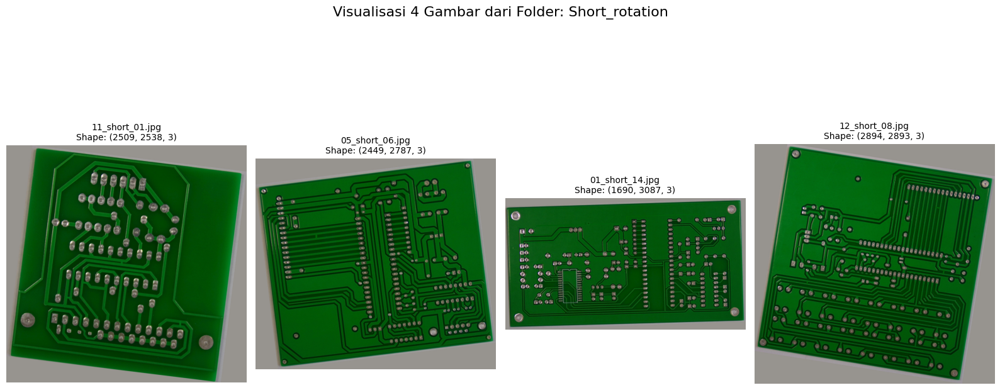

No of Short_rotation images:116


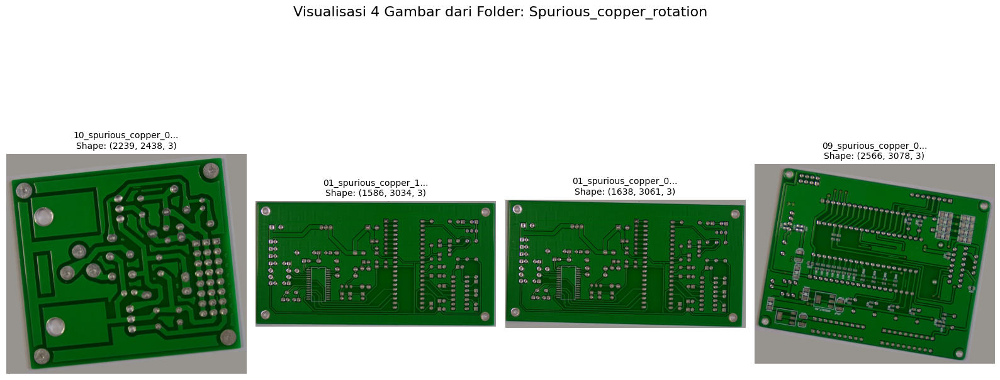

No of Spurious_copper_rotation images:116


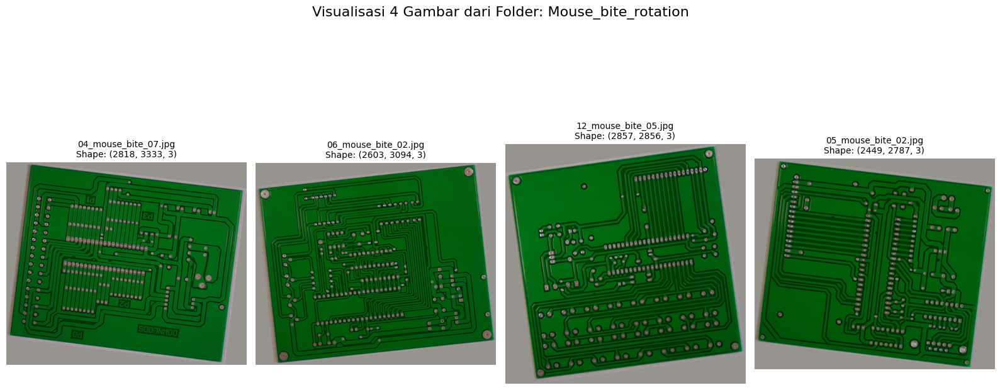

No of Mouse_bite_rotation images:115


In [ ]:
df_defect_rotated=pd.DataFrame(columns=['No of defect'])
for sub_cat in types_defect_rotated:
    imageVisualize(os.path.join(rotated_dir,sub_cat), num_to_show=4, random_sample=True)
    print(f'No of {sub_cat} images:{len(os.listdir(os.path.join(rotated_dir,sub_cat)))}')
    df_defect_rotated.loc[sub_cat]=len(os.listdir(os.path.join(rotated_dir,sub_cat)))

In [ ]:
df_defect_rotated

,No of defect
Missing_hole_rotation,115
Spur_rotation,115
Open_circuit_rotation,116
Short_rotation,116
Spurious_copper_rotation,116
Mouse_bite_rotation,115


PCB yang dirotasi penting fungsinya sebagai bagian dari teknik yang dikenal sebagai Augmentasi Data. Bayangkan jika kita hanya melatih model dengan gambar PCB yang selalu dalam posisi lurus dan tegak. Model akan belajar mengenali cacat hanya pada orientasi tersebut. Namun, di dunia nyata, PCB yang diinspeksi mungkin saja sedikit miring, terbalik, atau dalam orientasi yang berbeda. Jika model tidak pernah "melihat" cacat dalam posisi-posisi tersebut saat pelatihan, ia bisa gagal mengenali cacat yang sama persis hanya karena orientasinya berubah. Oleh karena itu, dengan membuat banyak salinan dari gambar PCB yang sama (beserta cacatnya) dan memutar (merotasi) salinan-salinan tersebut ke berbagai sudut, kita secara artifisial memperbanyak variasi data pelatihan. Ini mengajari model bahwa suatu cacat tetaplah cacat, meskipun posisi PCB berubah. Hasilnya, model menjadi jauh lebih tangguh (robust) dan fleksibel, mampu mendeteksi cacat dengan akurat terlepas dari orientasi PCB yang sebenarnya, sehingga lebih praktis dan efektif saat diterapkan di lingkungan industri.

In [ ]:
df_rotation_angle=pd.DataFrame(columns=['Line','Angle'])
for filename in rotated_angle_list:
    with open(os.path.join(rotated_dir,filename),'r') as f:
        lines=f.readlines()
        for line in lines:
            text,angle=line.split()
            df_rotation_angle=pd.concat([df_rotation_angle,pd.DataFrame({'Line':[text],'Angle':[angle]})],axis=0)

In [ ]:
df_rotation_angle

,Line,Angle
0,04_mouse_bite_06,-4
0,12_mouse_bite_04,10
0,01_mouse_bite_17,10
0,04_mouse_bite_08,7
0,01_mouse_bite_01,-6
...,...,...
0,04_open_circuit_20,-5
0,09_open_circuit_07,-3
0,04_open_circuit_08,-2
0,10_open_circuit_04,7


Mengetahui sudut rotasi (angle) dari setiap gambar PCB yang terrotasi berfungsi untuk memastikan dan mengontrol kualitas data augmentation yang telah dilakukan pada dataset. Dengan memiliki informasi sudut ini, dapat diverifikasi apakah proses rotasi telah diterapkan dengan benar dan mencakup rentang variasi orientasi yang cukup. Serta, dapar melakukan analisis distribusi sudut rotasi untuk melihat apakah ada bias atau kekurangan variasi di sudut tertentu, yang mungkin memerlukan augmentasi tambahan. Pada intinya, data sudut ini memberikan pemahaman mendalam tentang seberapa baik data pelatihan merepresentasikan variasi orientasi PCB di dunia nyata, yang pada akhirnya akan sangat mempengaruhi ketangguhan (robustness) model deteksi cacat yang saya bangun.


---



## Menganalisa Folder Annotations

---



In [ ]:
annote_dir=os.path.join(input_dir,'Annotations')
annote_dir

'/kaggle/input/pcb-defects/PCB_DATASET/Annotations'

In [ ]:
type_annot=os.listdir(annote_dir)
type_annot

['Mouse_bite',
 'Spur',
 'Open_circuit',
 'Short',
 'Missing_hole',
 'Spurious_copper']

In [ ]:
df_annot_nos=pd.DataFrame(columns=['No of annotations'])
for i in type_annot:
    df_annot_nos.loc[i]=len(os.listdir(os.path.join(annote_dir,i)))
df_annot_nos

,No of annotations
Mouse_bite,115
Spur,115
Open_circuit,116
Short,116
Missing_hole,115
Spurious_copper,116


In [ ]:
file_list=os.listdir(os.path.join(annote_dir,'Mouse_bite'))
file_list[0:5]

['01_mouse_bite_11.xml',
 '01_mouse_bite_17.xml',
 '08_mouse_bite_08.xml',
 '08_mouse_bite_02.xml',
 '07_mouse_bite_03.xml']

### Semua File memiliki format XML sehingga perlu penangan khusus terlebih dahulu, seperti *parse*

In [ ]:
import xml.etree.ElementTree as ET

In [ ]:
tree = ET.parse(os.path.join(os.path.join(annote_dir,'Mouse_bite'),'01_mouse_bite_11.xml'))
root = tree.getroot()

In [ ]:
def parse_xml(xml_file):

    data=[]
    tree = ET.parse(xml_file)
    root = tree.getroot()
    filename = root.find('filename').text
    width = int(root.find('size/width').text)
    height = int(root.find('size/height').text)
    for obj in root.findall('object'):
        name = obj.find('name').text
        xmin = int(obj.find('bndbox/xmin').text)
        ymin = int(obj.find('bndbox/ymin').text)
        xmax = int(obj.find('bndbox/xmax').text)
        ymax = int(obj.find('bndbox/ymax').text)

        data.append({
            'filename': filename,
            'width': width,
            'height': height,
            'class': name,
            'xmin': xmin,
            'ymin': ymin,
            'xmax': xmax,
            'ymax': ymax
        })

    return data

In [ ]:
data=[]
all_data=[]
for x in type_annot:
    for file in os.listdir(os.path.join(annote_dir,x)):
        xml_file_path=os.path.join(os.path.join(annote_dir,x),file)
        data=parse_xml(xml_file_path)
        all_data.extend(data)


In [ ]:
df_annot=pd.DataFrame(all_data)
df_annot

,filename,width,height,class,xmin,ymin,xmax,ymax
0,01_mouse_bite_11.jpg,3034,1586,mouse_bite,1199,966,1234,1004
1,01_mouse_bite_11.jpg,3034,1586,mouse_bite,2042,755,2073,786
2,01_mouse_bite_11.jpg,3034,1586,mouse_bite,1472,607,1507,639
3,01_mouse_bite_17.jpg,3034,1586,mouse_bite,2168,854,2200,887
4,01_mouse_bite_17.jpg,3034,1586,mouse_bite,1513,919,1545,957
...,...,...,...,...,...,...,...,...
2948,06_spurious_copper_09.jpg,2868,2316,spurious_copper,706,892,741,991
2949,06_spurious_copper_09.jpg,2868,2316,spurious_copper,1055,1136,1114,1171
2950,04_spurious_copper_04.jpg,3056,2464,spurious_copper,1796,1019,1839,1089
2951,04_spurious_copper_04.jpg,3056,2464,spurious_copper,474,1236,527,1382


In [ ]:
df_annot.info()

<class 'pandas.core.frame.DataFrame'>
RangeIndex: 2953 entries, 0 to 2952
Data columns (total 8 columns):
 #   Column    Non-Null Count  Dtype 
---  ------    --------------  ----- 
 0   filename  2953 non-null   object
 1   width     2953 non-null   int64 
 2   height    2953 non-null   int64 
 3   class     2953 non-null   object
 4   xmin      2953 non-null   int64 
 5   ymin      2953 non-null   int64 
 6   xmax      2953 non-null   int64 
 7   ymax      2953 non-null   int64 
dtypes: int64(6), object(2)
memory usage: 184.7+ KB


In [ ]:
df_annot.describe()

,width,height,xmin,ymin,xmax,ymax
count,2953.000000,2953.000000,2953.000000,2953.000000,2953.000000,2953.000000
mean,2736.187606,2157.239756,1394.106671,1047.755503,1464.942093,1115.333559
std,265.270485,274.740473,630.329705,450.621695,627.456070,451.260491
min,2240.000000,1586.000000,71.000000,67.000000,124.000000,137.000000
25%,2529.000000,2016.000000,893.000000,712.000000,968.000000,780.000000
50%,2775.000000,2159.000000,1407.000000,1034.000000,1487.000000,1103.000000
75%,2904.000000,2316.000000,1886.000000,1357.000000,1964.000000,1421.000000
max,3056.000000,2530.000000,2829.000000,2344.000000,2854.000000,2391.000000


In [ ]:
image_sizes = df_annot[['filename', 'width', 'height']].drop_duplicates()
print(f"Terdapat {len(image_sizes)} ukuran gambar yang unik.")
print(image_sizes['width'].value_counts())
print(image_sizes['height'].value_counts())

Terdapat 693 ukuran gambar yang unik.
width
3034    120
3056    120
2868     61
2759     60
2544     60
2904     60
2775     60
2529     60
2282     60
2240     32
Name: count, dtype: int64
height
1586    120
2464    120
2316     61
2154     60
2156     60
1921     60
2159     60
2530     60
2248     60
2016     32
Name: count, dtype: int64


In [ ]:
df_annot['class'].value_counts()

,count
class,
spurious_copper,503
missing_hole,497
mouse_bite,492
short,491
spur,488
open_circuit,482


In [ ]:
df_annot['bbox_width'] = df_annot['xmax'] - df_annot['xmin']
df_annot['bbox_height'] = df_annot['ymax'] - df_annot['ymin']
df_annot['bbox_aspect_ratio'] = df_annot['bbox_width'] / df_annot['bbox_height']
df_annot['bbox_area'] = df_annot['bbox_width'] * df_annot['bbox_height']
df_annot['bbox_center_x'] = df_annot['xmin'] + (df_annot['bbox_width'] / 2)
df_annot['bbox_center_y'] = df_annot['ymin'] + (df_annot['bbox_height'] / 2)
print(df_annot.head())

               filename  width  height       class  xmin  ymin  xmax  ymax  \
0  01_mouse_bite_11.jpg   3034    1586  mouse_bite  1199   966  1234  1004   
1  01_mouse_bite_11.jpg   3034    1586  mouse_bite  2042   755  2073   786   
2  01_mouse_bite_11.jpg   3034    1586  mouse_bite  1472   607  1507   639   
3  01_mouse_bite_17.jpg   3034    1586  mouse_bite  2168   854  2200   887   
4  01_mouse_bite_17.jpg   3034    1586  mouse_bite  1513   919  1545   957   

   bbox_width  bbox_height  bbox_aspect_ratio  bbox_area  bbox_center_x  \
0          35           38           0.921053       1330         1216.5   
1          31           31           1.000000        961         2057.5   
2          35           32           1.093750       1120         1489.5   
3          32           33           0.969697       1056         2184.0   
4          32           38           0.842105       1216         1529.0   

   bbox_center_y  
0          985.0  
1          770.5  
2          623.0  
3   

In [ ]:
import shutil

img_dir = "/kaggle/input/pcb-defects/PCB_DATASET/images"
source_dirs = [
    os.path.join(img_dir, "Missing_hole"),
    os.path.join(img_dir, "Mouse_bite"),
    os.path.join(img_dir, "Open_circuit"),
    os.path.join(img_dir, "Short"),
    os.path.join(img_dir, "Spur"),
    os.path.join(img_dir, "Spurious_copper")
]

destination_dir = "/kaggle/working/images_combined"
os.makedirs(destination_dir, exist_ok=True)
for source_dir in source_dirs:
    for file in files:
        file_path = os.path.join(source_dir, file)
        if os.path.isfile(file_path):
            shutil.copy(file_path, destination_dir)


files_in_combined = os.listdir(destination_dir)

In [ ]:
destination_dir

'/kaggle/working/images_combined'

Text(0.5, 0, 'No of defects in one PCB')

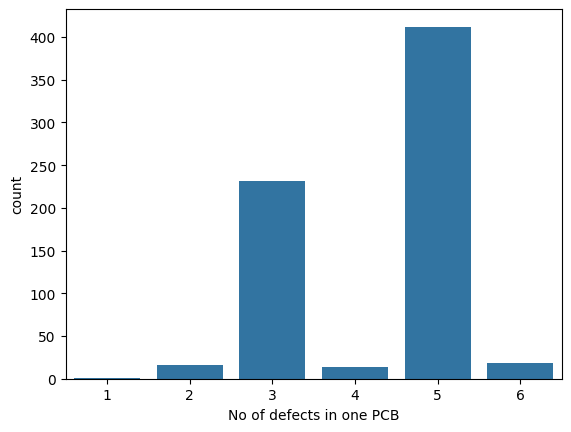

In [ ]:
df_multiple_defects=pd.DataFrame(df_annot['filename'].value_counts())
sns.countplot(df_multiple_defects,x='count')
plt.xlabel('No of defects in one PCB')

### Dari plot ini, ditemukan bahwa sangat jarang ditemukan PCB yang hanya memiliki satu atau dua cacat. Jumlah kejadian untuk 1 dan 2 cacat per PCB sangat rendah, bahkan hampir nol untuk 1 cacat.

---



- Terdapat dua puncak dominan dalam distribusi:

 Sebagian besar PCB cenderung memiliki 3 cacat. Namun, jumlah cacat yang paling sering muncul adalah 5 cacat per PCB, yang ditunjukkan oleh bar tertinggi pada plot. Ini mengindikasikan bahwa skenario di mana satu PCB memiliki 5 kerusakan sekaligus adalah yang paling umum dalam dataset.PCB dengan 4 atau 6 cacat juga muncul, meskipun dengan frekuensi yang jauh lebih rendah dibandingkan dengan 3 atau 5 cacat.

- Dominasi Multi-Cacat

 Insight paling signifikan adalah bahwa sebagian besar gambar PCB dalam dataset saya mengandung lebih dari satu cacat. Ini sangat berbeda dari asumsi yang mungkin menduga bahwa satu gambar hanya akan memiliki satu cacat.

- Cacat Jamak Sebagai Norma

  Dengan 5 cacat per PCB menjadi frekuensi paling umum, ini menunjukkan bahwa model deteksi objek saya harus dirancang dan dioptimalkan untuk mampu mendeteksi dan mengidentifikasi banyak objek (cacat) dalam satu gambar.

- Implikasi untuk Desain Model

  Kebutuhan untuk mendeteksi banyak cacat dalam satu gambar akan memengaruhi pilihan arsitektur model (misalnya, model berbasis deteksi multi-objek seperti YOLO, Faster R-CNN, SSD), strategi pelatihan (misalnya, bagaimana loss function menangani banyak bounding box), dan metrik evaluasi (misalnya, menggunakan Mean Average Precision yang relevan untuk multi-objek).

In [ ]:
def draw_bounding_boxes(image_path, bounding_boxes, annotations):
    img = plt.imread(image_path)
    fig, ax = plt.subplots(figsize=(15,10))
    ax.imshow(img)
    for i, bbox in enumerate(bounding_boxes):
        min_x, min_y, max_x, max_y = bbox
        width = max_x - min_x
        height = max_y - min_y
        rect = patches.Rectangle((min_x, min_y), width, height, linewidth=1, edgecolor='red', facecolor='none')
        ax.add_patch(rect)
        centroid_x = (min_x + max_x) / 2
        centroid_y = (min_y + max_y) / 2
        ax.annotate(annotations[i], (max_x, min_y), textcoords="offset points", xytext=(5,-10),
                    fontsize=10, color='red', bbox=dict(boxstyle='round,pad=0.5', fc='yellow', alpha=0.5))

    plt.grid(False)
    plt.xticks([])
    plt.yticks([])
    plt.show()

In [ ]:
filepath=img_path_list[0]
filename=re.sub(r'.+/([\w_]+\.jpg)',r'\1',filepath)
filename

'01_mouse_bite_20.jpg'

In [ ]:
def visualize_annotations(list_image_path,df):
    for i in list_image_path:
        filepath=i
        filename=re.sub(r'.+/([\w_]+\.jpg)',r'\1',filepath)
        df_selected=df[df['filename']==filename]
        width=df_selected['width'].values
        height=df_selected['height'].values
        class_name=df_selected['class'].values
        xmin=df_selected['xmin'].values
        ymin=df_selected['ymin'].values
        xmax=df_selected['xmax'].values
        ymax=df_selected['ymax'].values

        bboxes = list(zip(xmin, ymin, xmax, ymax))
        annotations = list(class_name)
        draw_bounding_boxes(filepath, bboxes, annotations)

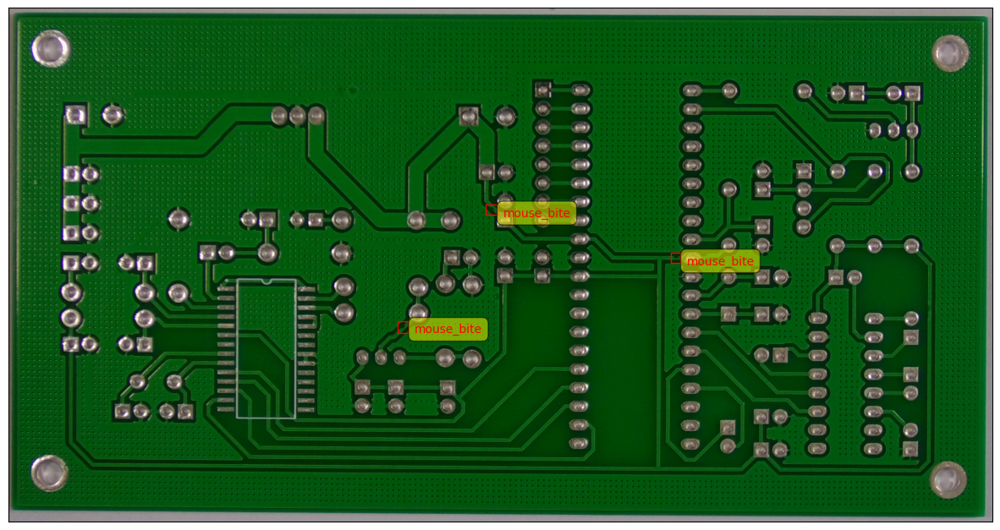

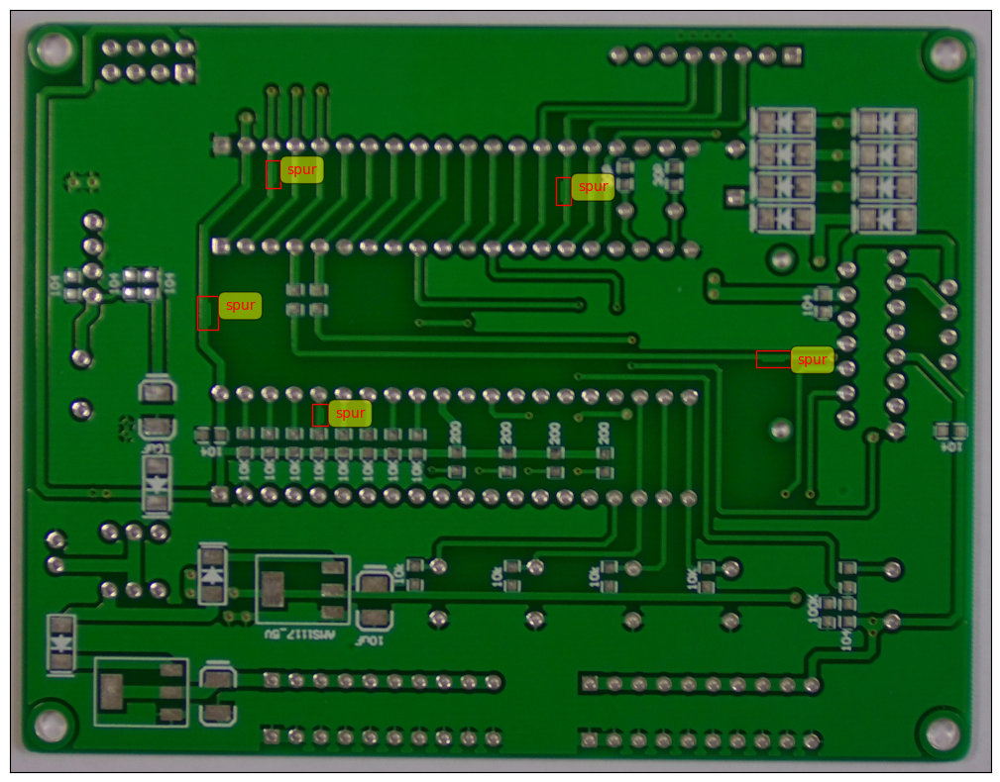

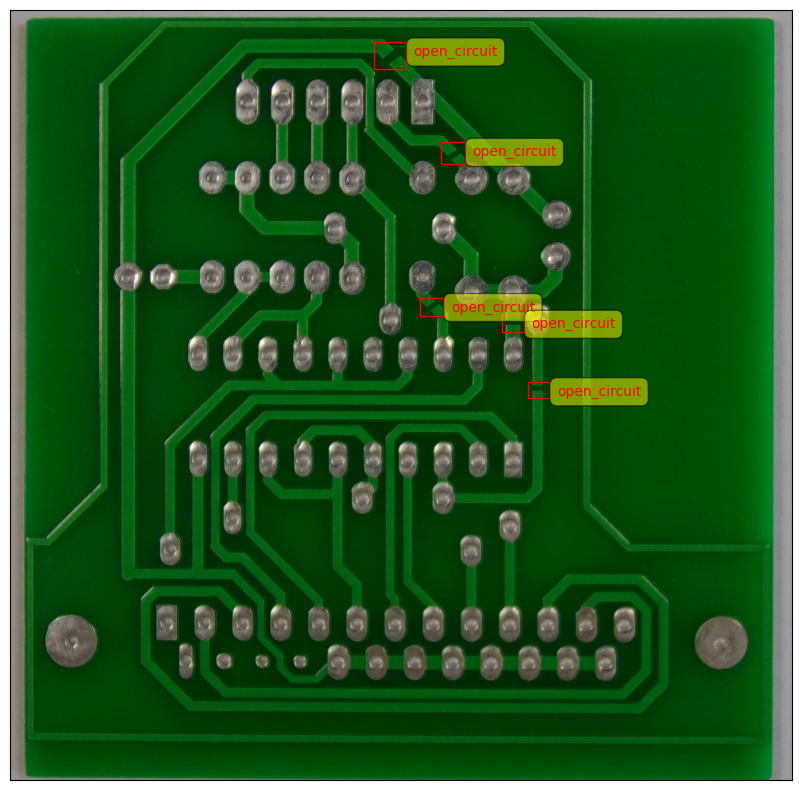

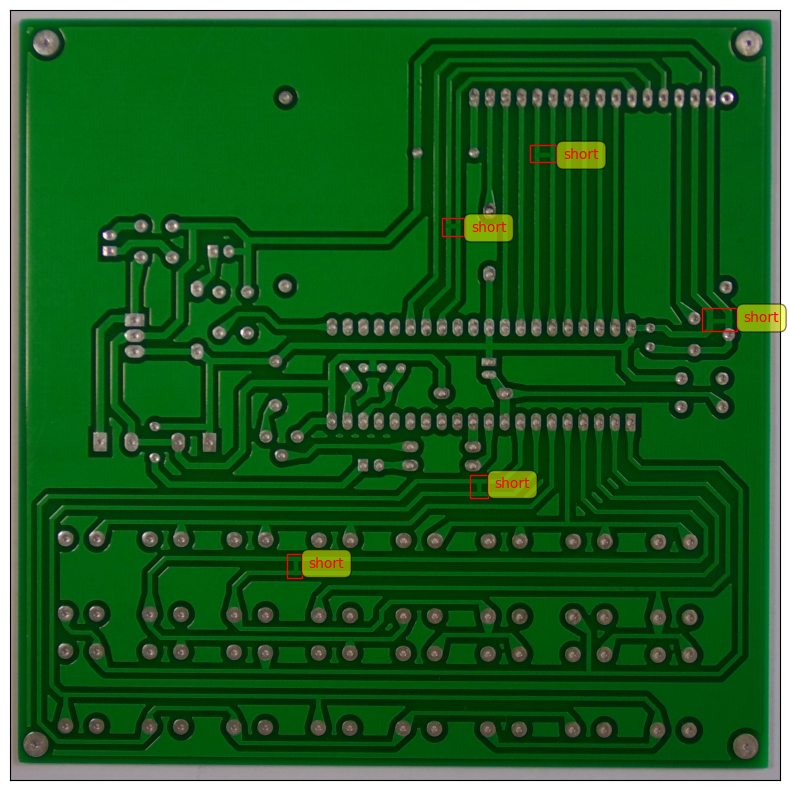

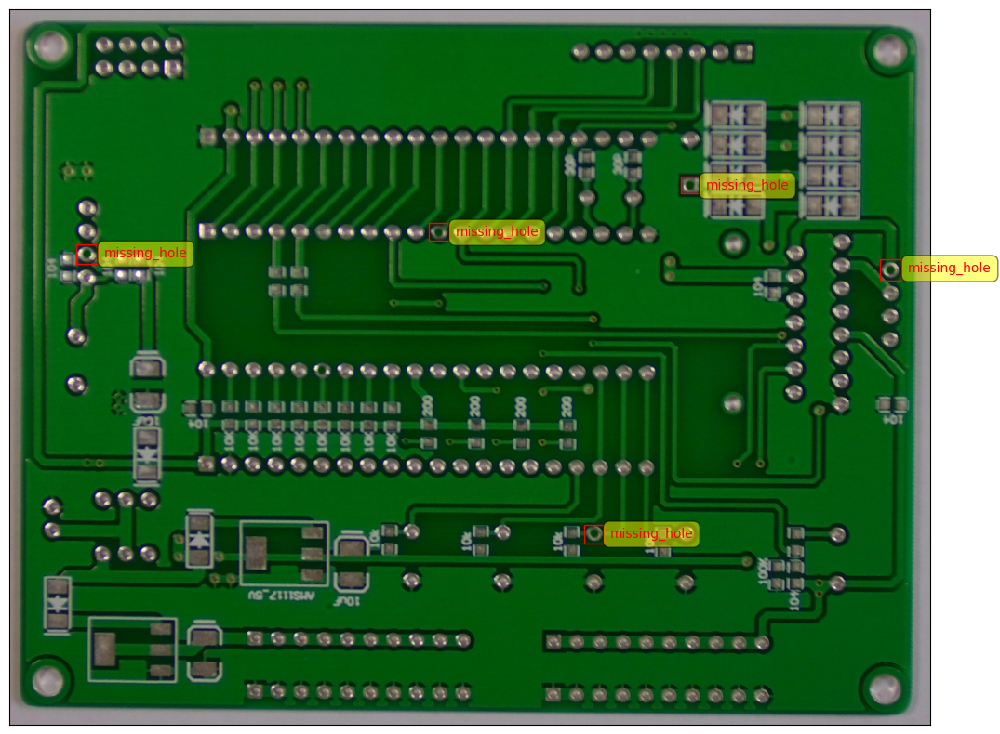

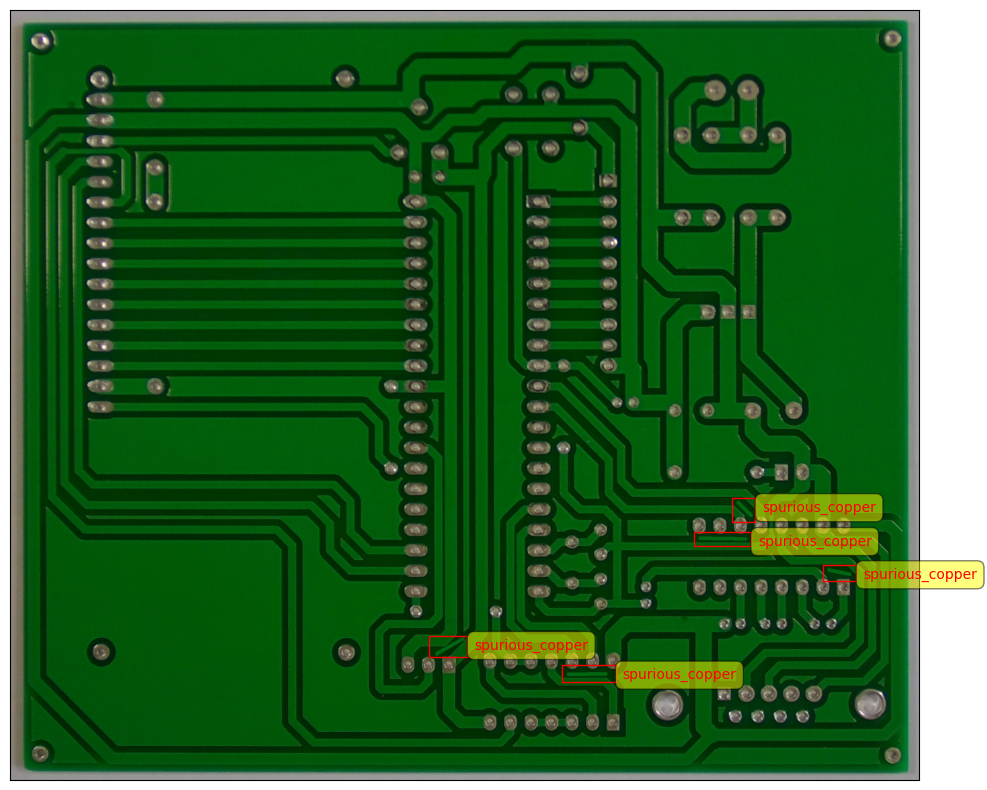

In [ ]:
selected_image_paths = []
seen_classes = set()

for index, row in df_annot.iterrows():
    if row['class'] not in seen_classes:
        img_filename = row['filename']
        for sub_cat in types_defect:
            full_path = os.path.join(img_dir, sub_cat, img_filename)
            if os.path.exists(full_path):
                selected_image_paths.append(full_path)
                seen_classes.add(row['class'])
                break
    if len(seen_classes) == len(types_defect):
        break

visualize_annotations(selected_image_paths, df_annot)

### Visualisasi Anotasi

Di bagian ini, kami melakukann visualisasi langsung seperti apa bentuk cacat di PCB itu, lengkap sama kotak (bounding box) yang menandai lokasinya dan label nama cacatnya.


1.  **Memahami Konteks *Defect* pada setiap PCB:**

  Dapat dilihat cacat itu ada di mana pada PCB. Apakah di jalur tembaga, di area kosong, di dekat lubang, atau di tepi board. Menambah pemahaman tentang pola spasial cacat, tidak melihat dari heatmap saja.
2.  **Variasi Bentuk dan Ukuran Cacat:**

  Dapat dilihat variasi "bentukan" cacatnya di dunia nyata. Ada cacat 'Short' yang tipis banget, ada 'Mouse_bite' yang lekukannya beda-beda, dll. Menunjukan bagaimana kompleksnya bentuk cacat yang harus bisa dideteksi model.
3.  **Gambar dengan Banyak Cacat:**

  Visualisasi ini juga nunjukin contoh gambar PCB yang punya ***multiple defects***. Dapat dilihat ada beberapa kotak merah dalam satu foto. Ini menandakan kalau model deteksi objek kita perlu menemukan tidak hanya satu cacat, tapi mungkin beberapa cacat sekaligus di satu gambar.


4.  **Validasi Anotasi:**

 Melakukan validasi ulang apakah kotak anotasi itu pas di lokasi ***defect*** dan labelnya sudah sesuai jenis cacatnya. Memastikan data latih berkualitas.


In [ ]:
print("PyTorch Version:", torch.__version__)
device = torch.device("cuda" if torch.cuda.is_available() else "cpu")
print(f"Using device: {device}")

PyTorch Version: 2.6.0+cu124
Using device: cpu


In [ ]:
img_dir = destination_dir
if 'class' in df_annot.columns:
    df_annot = df_annot.rename(columns={'class': 'class_name'})
print(df_annot.head())

class_names = sorted(df_annot['class_name'].unique())
num_classes = len(class_names)
unique_filenames = df_annot['filename'].unique()
train_files, test_val_files = train_test_split(unique_filenames, test_size=0.3, random_state=42)
val_files, test_files = train_test_split(test_val_files, test_size=0.5, random_state=42) # 0.3 * 0.5 = 0.15

train_df = df_annot[df_annot['filename'].isin(train_files)].reset_index(drop=True)
val_df = df_annot[df_annot['filename'].isin(val_files)].reset_index(drop=True)
test_df = df_annot[df_annot['filename'].isin(test_files)].reset_index(drop=True)
dataset_sizes = {'train': len(train_df), 'val': len(val_df), 'test': len(test_df)}

data_transforms = {
    'train': transforms.Compose([
        transforms.Resize((224, 224)),
        transforms.RandomHorizontalFlip(),
        transforms.RandomRotation(15),
        transforms.ColorJitter(brightness=0.2, contrast=0.2, saturation=0.2, hue=0.1),
        transforms.ToTensor(),
        transforms.Normalize([0.485, 0.456, 0.406], [0.229, 0.224, 0.225])
    ]),
    'val': transforms.Compose([
        transforms.Resize((224, 224)),
        transforms.ToTensor(),
        transforms.Normalize([0.485, 0.456, 0.406], [0.229, 0.224, 0.225])
    ]),
}

class PCBCropDataset(Dataset):
    def __init__(self, dataframe, image_dir, class_names, transform=None):
        self.df = dataframe
        self.image_dir = image_dir
        self.transform = transform
        self.class_to_idx = {cls_name: i for i, cls_name in enumerate(class_names)}

    def __len__(self):
        return len(self.df)

    def __getitem__(self, idx):
        row = self.df.iloc[idx]
        img_filename = row['filename']
        box = (row['xmin'], row['ymin'], row['xmax'], row['ymax'])
        label_idx = self.class_to_idx[row['class_name']]

        try:
            img_path = os.path.join(self.image_dir, img_filename)
            image = Image.open(img_path).convert('RGB')
            cropped_image = image.crop(box)
        except FileNotFoundError:
            return torch.zeros((3, 224, 224)), -1
        if self.transform:
            cropped_image = self.transform(cropped_image)
        return cropped_image, label_idx

               filename  width  height  class_name  xmin  ymin  xmax  ymax  \
0  01_mouse_bite_11.jpg   3034    1586  mouse_bite  1199   966  1234  1004   
1  01_mouse_bite_11.jpg   3034    1586  mouse_bite  2042   755  2073   786   
2  01_mouse_bite_11.jpg   3034    1586  mouse_bite  1472   607  1507   639   
3  01_mouse_bite_17.jpg   3034    1586  mouse_bite  2168   854  2200   887   
4  01_mouse_bite_17.jpg   3034    1586  mouse_bite  1513   919  1545   957   

   bbox_width  bbox_height  bbox_aspect_ratio  bbox_area  bbox_center_x  \
0          35           38           0.921053       1330         1216.5   
1          31           31           1.000000        961         2057.5   
2          35           32           1.093750       1120         1489.5   
3          32           33           0.969697       1056         2184.0   
4          32           38           0.842105       1216         1529.0   

   bbox_center_y  
0          985.0  
1          770.5  
2          623.0  
3   

In [ ]:
img_dir_combined = destination_dir
defect_patches = []
defect_labels = []
patch_sizes = []
df_subset = df_annot

for index, row in df_subset.iterrows():
    img_filename = row['filename']
    box = (row['xmin'], row['ymin'], row['xmax'], row['ymax'])
    class_name = row['class_name']
    img_path = os.path.join(img_dir_combined, img_filename)

    image = Image.open(img_path).convert('L')
    cropped_image = image.crop(box)
    defect_patches.append(np.array(cropped_image))
    defect_labels.append(class_name)
    patch_sizes.append(cropped_image.size)


print(f"Jumlah patch per kelas: {pd.Series(defect_labels).value_counts()}")

Jumlah patch per kelas: spurious_copper    503
missing_hole       497
mouse_bite         492
short              491
spur               488
open_circuit       482
Name: count, dtype: int64


## Eksplorasi Visual: Karakteristik dan Variasi Setiap Jenis Cacat PCB

---



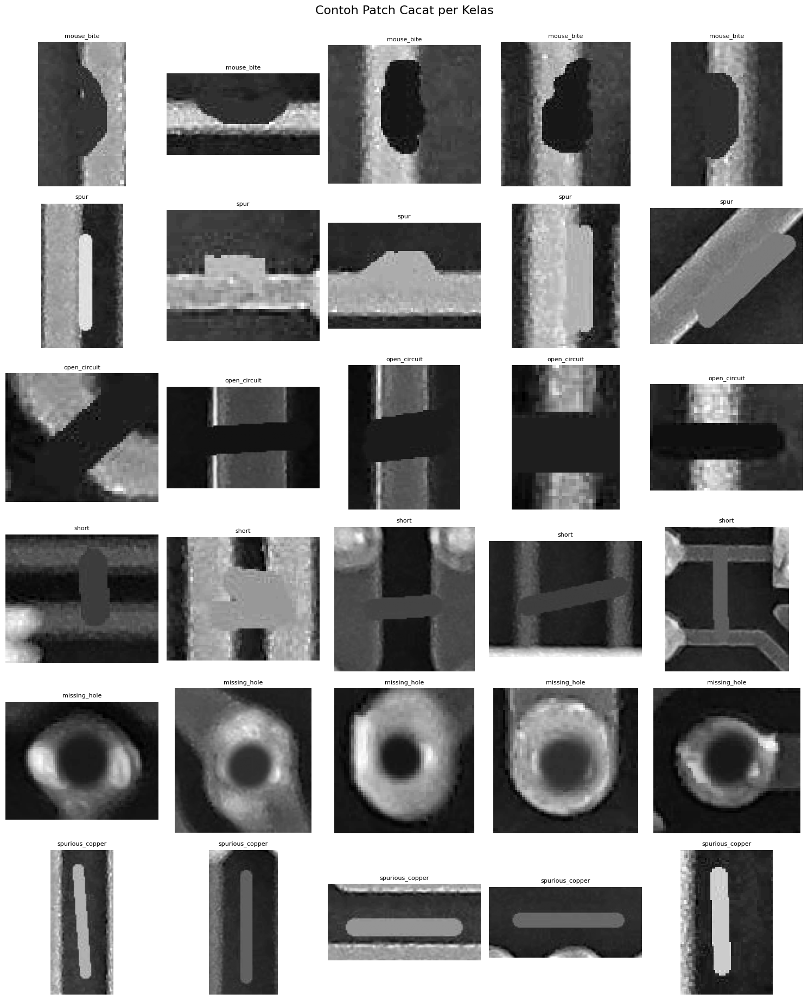

In [ ]:
df_patches = pd.DataFrame({'patch': defect_patches, 'label': defect_labels})
defect_classes = df_patches['label'].unique()
samples_per_class = 5

plt.figure(figsize=(15, len(defect_classes) * 3))

for i, defect_class in enumerate(defect_classes):
    df_class_patches = df_patches[df_patches['label'] == defect_class]
    if len(df_class_patches) > samples_per_class:
        sampled_patches = df_class_patches.sample(samples_per_class, random_state=42)['patch'].tolist()
    else:
        sampled_patches = df_class_patches['patch'].tolist()

    for j, patch_array in enumerate(sampled_patches):
        ax = plt.subplot(len(defect_classes), samples_per_class, i * samples_per_class + j + 1)
        ax.imshow(patch_array, cmap='gray')
        ax.set_title(defect_class, fontsize=8)
        ax.axis('off')

total_plots_needed = len(defect_classes) * samples_per_class
current_plots_shown = i * samples_per_class + j + 1 if 'i' in locals() else 0
for k in range(current_plots_shown, total_plots_needed):
    ax = plt.subplot(len(defect_classes), samples_per_class, k + 1)
    ax.axis('off')

plt.tight_layout()
plt.suptitle('Contoh Patch Cacat per Kelas', y=1.02, fontsize=16)
plt.show()

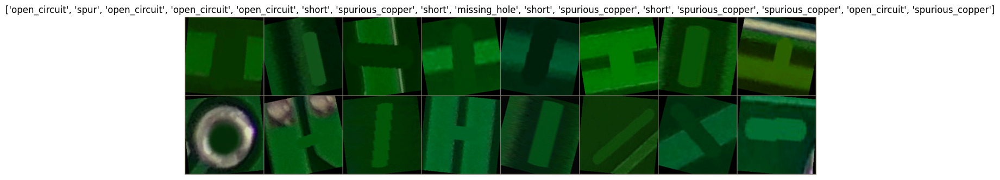

In [ ]:
train_dataset = PCBCropDataset(train_df, img_dir, class_names, transform=data_transforms['train'])
val_dataset = PCBCropDataset(val_df, img_dir, class_names, transform=data_transforms['val'])
test_dataset = PCBCropDataset(test_df, img_dir, class_names, transform=data_transforms['val'])

batch_size = 16

dataloaders = {
    'train': DataLoader(train_dataset, batch_size=batch_size, shuffle=True, num_workers=os.cpu_count()),
    'val': DataLoader(val_dataset, batch_size=batch_size, shuffle=False, num_workers=os.cpu_count()),
    'test': DataLoader(test_dataset, batch_size=batch_size, shuffle=False, num_workers=os.cpu_count())
}

inputs, classes_idx = next(iter(dataloaders['train']))
out = utils.make_grid(inputs)

def imshow(inp, title=None):
    inp = inp.numpy().transpose((1, 2, 0))
    mean = np.array([0.485, 0.456, 0.406]); std = np.array([0.229, 0.224, 0.225])
    inp = std * inp + mean; inp = np.clip(inp, 0, 1)
    plt.figure(figsize=(15, 8)); plt.imshow(inp)
    if title is not None: plt.title(title)
    plt.axis('off'); plt.show()

imshow(out, title=[class_names[x] for x in classes_idx])

1. mouse_bite:

 Interpretasi: Cacat ini terlihat seperti lekukan atau "gigitan" pada tepi jalur PCB, seringkali berbentuk iregular atau cekungan tajam. Variasinya menunjukkan ukuran dan kedalaman lekukan yang berbeda.

 Implikasi: Model perlu mampu mendeteksi bentuk cekungan pada garis tepi, yang bisa jadi lebih menantang jika ukurannya sangat kecil atau warnanya mirip dengan latar belakang.

2. spur:

 Interpretasi: Spur tampak sebagai tonjolan kecil, "taji", atau gumpalan material yang tidak diinginkan yang menonjol dari jalur PCB. Bentuknya bisa bervariasi dari memanjang hingga lebih bulat.

 Implikasi: Model harus peka terhadap fitur menonjol yang kecil dan tidak terduga pada permukaan PCB.

3. open_circuit:

 Interpretasi: Cacat ini jelas terlihat sebagai diskontinuitas atau celah pada jalur konduktif PCB. Jalur yang seharusnya tersambung kini terputus, menciptakan celah hitam.

 Implikasi: Ini adalah cacat yang relatif mudah dikenali karena karakteristik visualnya yang sangat jelas: adanya "ruang kosong" atau "pemutusan" pada jalur. Model harus fokus pada deteksi celah dalam struktur garis.

4. short:

 Interpretasi: Short atau hubungan pendek tampak sebagai jembatan material yang tidak diinginkan yang menghubungkan dua jalur konduktif atau area yang seharusnya terpisah. Bisa berupa garis tipis atau gumpalan yang menghubungkan dua titik.

 Implikasi: Ini adalah cacat kritis yang bisa mirip dengan spur tapi dengan konteks "menghubungkan dua area". Model perlu membedakan antara material berlebih yang berdiri sendiri (spur) dengan material berlebih yang menghubungkan (short).

5. missing_hole:

 Interpretasi: Cacat ini jelas menunjukkan lubang yang seharusnya ada pada PCB tetapi tidak ada atau tidak terbentuk sempurna. Area yang seharusnya berlubang kini tertutup atau hanya berupa lekukan dangkal.

 Implikasi: Model harus mampu mengidentifikasi ketiadaan fitur berbentuk lingkaran (lubang) yang diharapkan, atau adanya area solid yang seharusnya kosong.

6. spurious_copper:

 Interpretasi: Ini terlihat sebagai sisa-sisa tembaga yang tidak diinginkan atau "serpihan" tembaga di area yang seharusnya kosong. Bentuknya bisa sangat bervariasi, dari garis-garis tipis hingga bercak-bercak.

 Implikasi: Cacat ini mungkin menantang karena bentuk dan ukurannya bisa sangat beragam dan ireguler. Model perlu fleksibel dalam mengenali berbagai bentuk "material asing" di area kosong.





## Visualisasi "Analisis Tekstur GLCM Patch Cacat per Kelas"

---



Selain karakteristik bentuk, ukuran, dan intensitas piksel, tekstur merupakan fitur visual yang sangat kuat untuk membedakan objek. Dalam konteks deteksi cacat PCB, tekstur dapat mengungkapkan pola spasial piksel yang unik untuk setiap jenis cacat. Saya menggunakan GLCM (Gray-Level Co-occurrence Matrix) untuk mengekstrak fitur tekstur seperti Contrast, Correlation, Energy, dan Homogeneity, dan kemudian menganalisis distribusinya per kelas cacat.

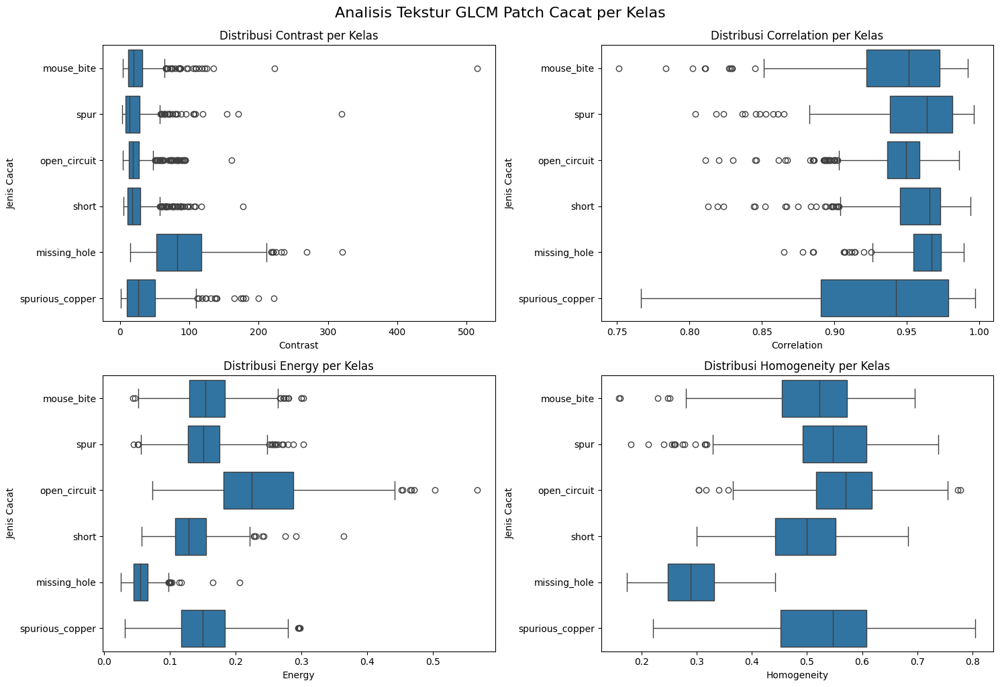

In [ ]:
from skimage.feature import graycomatrix, graycoprops

glcm_features_list = []
distances = [1]
angles = [0, np.pi/4, np.pi/2, 3*np.pi/4]
for i, patch_array in enumerate(defect_patches):
    label = defect_labels[i]
    if patch_array.dtype != np.uint8:
        patch_array = patch_array.astype(np.uint8)
    if patch_array.shape[0] < 2 or patch_array.shape[1] < 2:
        continue
    glcm = graycomatrix(patch_array, distances=distances, angles=angles, levels=256, symmetric=True, normed=True)
    contrast = graycoprops(glcm, 'contrast')[0, 0]
    correlation = graycoprops(glcm, 'correlation')[0, 0]
    energy = graycoprops(glcm, 'energy')[0, 0]
    homogeneity = graycoprops(glcm, 'homogeneity')[0, 0]


    glcm_features_list.append({
        'label': label,
        'contrast': contrast,
        'correlation': correlation,
        'energy': energy,
        'homogeneity': homogeneity
    })


df_glcm = pd.DataFrame(glcm_features_list)
fig, axes = plt.subplots(2, 2, figsize=(15, 10))
axes = axes.flatten()

metrics = ['contrast', 'correlation', 'energy', 'homogeneity']
titles = ['Distribusi Contrast per Kelas', 'Distribusi Correlation per Kelas',
          'Distribusi Energy per Kelas', 'Distribusi Homogeneity per Kelas']

for i, metric in enumerate(metrics):
    sns.boxplot(data=df_glcm, y='label', x=metric, orient='h', ax=axes[i])
    axes[i].set_title(titles[i])
    axes[i].set_xlabel(metric.capitalize())
    axes[i].set_ylabel('Jenis Cacat')
plt.tight_layout()
plt.suptitle('Analisis Tekstur GLCM Patch Cacat per Kelas', y=1.02, fontsize=16)
plt.show()

### Distribusi Contrast per Kelas
- Fitur Kontras sangat efektif dalam membedakan cacat dengan batas tajam atau celah (misalnya open_circuit, mouse_bite, missing_hole) dari cacat yang melibatkan material tambahan yang lebih homogen (misalnya short, spur, spurious_copper). Cacat dengan diskontinuitas cenderung memiliki kontras yang lebih tinggi.

### Distribusi Correlation per Kelas
- Korelasi adalah pembeda kuat untuk mengidentifikasi cacat yang melibatkan pola material yang lebih terstruktur atau seragam (misalnya short, spurious_copper). Cacat ini menunjukkan korelasi yang tinggi dan terkonsentrasi, menandakan keteraturan piksel yang jelas.

### Distribusi Energy per Kelas

- Energi secara langsung mengindikasikan homogenitas tekstur. Cacat seperti short dan spurious_copper menunjukkan homogenitas yang lebih tinggi, menguatkan bahwa mereka memiliki pola piksel yang lebih seragam. Sebaliknya, missing_hole memiliki energi terendah, menyoroti teksturnya yang paling heterogen.

### Distribusi Homogeneity per Kelas
- Homogenitas memperkuat temuan Energi, menegaskan kehalusan dan keseragaman tekstur pada cacat seperti short dan spurious_copper. Ini menawarkan detail tambahan untuk membedakan antara cacat halus dan yang lebih kasar atau terputus.


---




1. Secara keseluruhan, analisis tekstur GLCM ini menunjukkan bahwa fitur tekstur adalah pembeda yang sangat kuat dan komplementer untuk membedakan berbagai jenis cacat PCB. Cacat dapat dikelompokkan berdasarkan karakteristik teksturnya:

2. Cacat seperti open_circuit, mouse_bite, dan missing_hole cenderung memiliki tekstur yang lebih kasar (kontras tinggi, energi/homogenitas rendah), menunjukkan diskontinuitas atau perubahan mendadak.

3. Cacat seperti short dan spurious_copper cenderung memiliki tekstur yang lebih halus dan seragam (korelasi tinggi, energi/homogenitas tinggi), menunjukkan adanya material tambahan dengan pola yang lebih teratur.

## Analisa Distribusi Aspek Rasio (Aspect Ratio) Bounding Box per Kelas Cacat

---



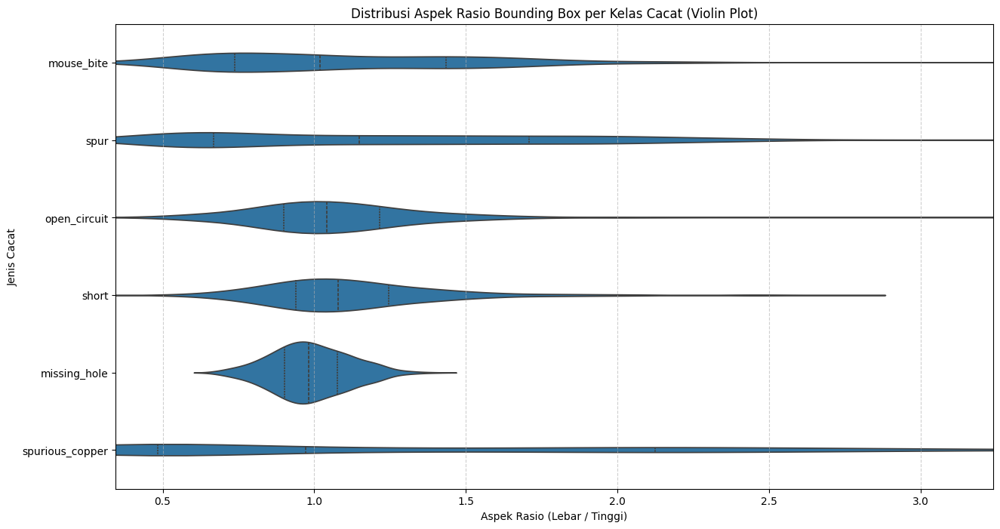

In [ ]:
plt.figure(figsize=(15, 8))
sns.violinplot(data=df_annot, y='class_name', x='bbox_aspect_ratio', orient='h', inner='quartile')
plt.title('Distribusi Aspek Rasio Bounding Box per Kelas Cacat (Violin Plot)')
plt.xlabel('Aspek Rasio (Lebar / Tinggi)')
plt.ylabel('Jenis Cacat')
plt.xlim(df_annot['bbox_aspect_ratio'].quantile(0.01), df_annot['bbox_aspect_ratio'].quantile(0.99))

plt.grid(axis='x', linestyle='--', alpha=0.6)

1. Missing_hole memiliki bentuk yang sangat konsisten (mendekati persegi, aspek rasio ~1.0). Dapat ditarik kesimpulan, apabila anchor box dengan aspek rasio 1.0 akan sangat efisien untuk mendeteksi cacat ini.

2. Cacat seperti open_circuit, short, spur, dan spurious_copper menunjukkan variasi bentuk yang signifikan, cenderung memanjang baik secara vertikal (<1.0) maupun horizontal (>1.0). Hal ini mengindikasikan bahwa model deteksi perlu menggunakan berbagai anchor box dengan aspek rasio yang beragam (memanjang vertikal, persegi, dan memanjang horizontal) untuk secara efektif mendeteksi cacat-cacat ini.

3. Mouse_bite memiliki distribusi aspek rasio yang paling bervariasi dan luas, menunjukkan bentuk yang tidak konsisten. Ini menuntut model yang sangat fleksibel dan mungkin memerlukan anchor box yang lebih luas rentang aspek rasionya, atau teknik deteksi yang lebih adaptif untuk menangani variasi bentuknya.

4. Analisis ini mengonfirmasi bahwa setiap jenis cacat memiliki karakteristik bentuk dominan yang dapat dimanfaatkan. Misalnya, missing_hole yang sangat spesifik berbentuk persegi, sementara yang lain lebih memanjang.

5. Visualisasi ini juga secara tidak langsung memvalidasi bahwa anotasi bounding box telah dilakukan dengan baik dan menangkap bentuk aktual dari cacat.

## Heatmap Spasial Lokasi ***Defect***

---



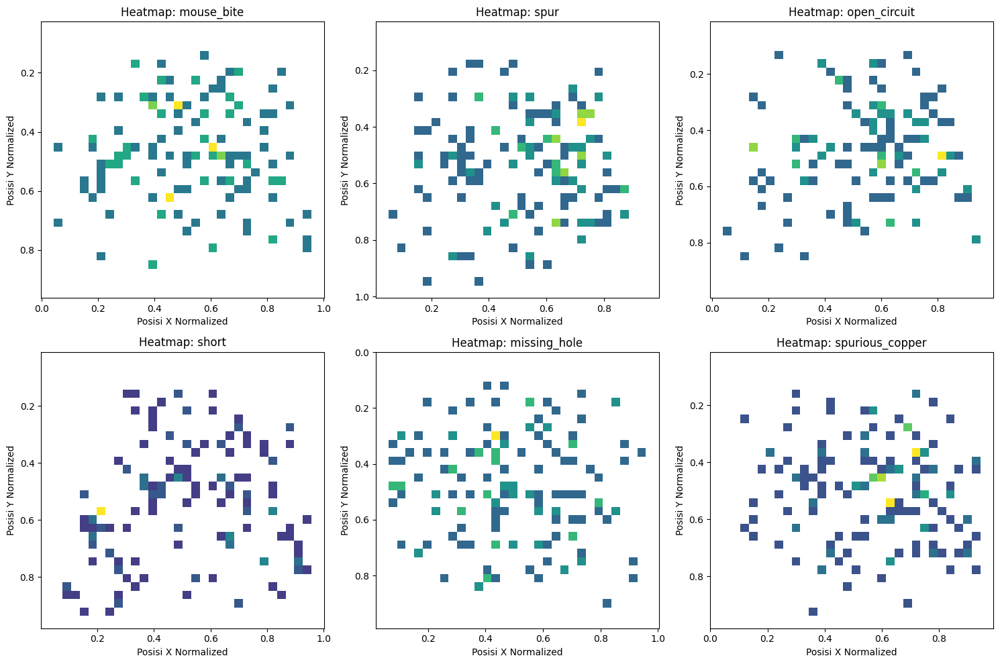

In [ ]:
defect_classes = df_annot['class_name'].unique()
df_annot['bbox_center_x_normalized'] = df_annot['bbox_center_x'] / df_annot['width']
df_annot['bbox_center_y_normalized'] = df_annot['bbox_center_y'] / df_annot['height']
num_classes = len(defect_classes)
num_cols = 3
num_rows = (num_classes + num_cols - 1) // num_cols

fig, axes = plt.subplots(num_rows, num_cols, figsize=(15, num_rows * 5))
axes = axes.flatten()

for i, defect_class in enumerate(defect_classes):
    ax = axes[i]
    df_class = df_annot[df_annot['class_name'] == defect_class]

    if not df_class.empty:
        sns.histplot(x=df_class['bbox_center_x_normalized'], y=df_class['bbox_center_y_normalized'], bins=30, pthresh=.1, cmap="viridis", ax=ax)
        ax.set_title(f'Heatmap: {defect_class}')
        ax.set_xlabel('Posisi X Normalized')
        ax.set_ylabel('Posisi Y Normalized')
        ax.invert_yaxis()
    else:
        ax.set_title(f'No data for: {defect_class}')
        ax.axis('off')
for j in range(i + 1, len(axes)):
    axes[j].axis('off')

plt.tight_layout()
plt.show()


### Tujuan:

1. Mengidentifikasi area-area pada layout PCB yang secara statistik memiliki probabilitas tertinggi untuk ditemukan cacat (hotspot).

2. engeksplorasi apakah jenis cacat yang berbeda memiliki pola spasial kemunculan yang unik atau terkonsentrasi pada area spesifik.

3. Memberikan wawasan potensial mengenai akar penyebab cacat dalam proses produksi yang mungkin terkait dengan lokasi fisik pada board.

### Interpretasi Visualisasi:

1. Heatmap Global Lokasi Cacat (Semua Cacat):
Gambar menampilkan heatmap untuk setiap kelas cacat secara individual. Namun, kita dapat mengamati pola umum dari keenam heatmap untuk mendapatkan gambaran "global" secara implisit.

   Secara keseluruhan, terlihat bahwa cacat cenderung tersebar di sebagian besar area PCB, namun ada beberapa area dengan konsentrasi yang lebih tinggi. Area dengan intensitas warna kuning (kepadatan tinggi) sering terlihat di sekitar area tengah atas, tengah bawah, dan juga di beberapa titik sporadis lainnya. Tidak ada satu area tunggal yang mendominasi sebagai hotspot mutlak untuk semua jenis cacat, menunjukkan bahwa cacat dapat muncul di berbagai lokasi.

2. Heatmap Lokasi Cacat per Kelas:

 Serangkaian heatmap ini menampilkan distribusi spasial pusat bbox untuk setiap jenis cacat secara individual. Perbandingan antar heatmap ini sangat krusial untuk mengungkap pola spesifik per kelas.

## Analisis per kelas cacat mengungkapkan pola spasial yang beragam:

1. Mouse Bite: Cacat "Mouse Bite" menunjukkan pola yang cukup tersebar, namun ada beberapa konsentrasi kecil di bagian tengah atas dan tengah-kiri bawah.

2. Spur: Cacat "Spur" menunjukkan beberapa area hotspot, terutama di bagian tengah atas dan sedikit di area tengah-kanan.

3. Open Circuit: Cacat "Open Circuit" terlihat memiliki konsentrasi yang cukup jelas di bagian tengah-atas dan beberapa bintik-bintik lain yang tersebar.

4. Short: Cacat "Short" menunjukkan hotspot yang signifikan di bagian kiri tengah, serta beberapa area dengan kepadatan sedang di bagian tengah-atas dan kanan bawah.

5. Missing Hole: Cacat "Missing Hole" memiliki distribusi yang paling tersebar dari semua jenis cacat, tanpa ada konsentrasi yang sangat menonjol di satu area tertentu, meskipun ada sedikit peningkatan kepadatan di sekitar area tengah. Ini mungkin mengindikasikan bahwa masalah pengeboran bisa terjadi di berbagai lokasi secara acak.

6. Spurious Copper: Cacat "Spurious Copper" menunjukkan beberapa area dengan kepadatan tinggi di bagian tengah-atas dan sedikit di area tengah-kanan, mirip dengan pola "Spur".

Implikasi:

Wawasan spasial dari heatmap ini sangat penting. Identifikasi area hotspot dapat menginformasikan strategi inspeksi kualitas yang lebih terfokus. Selain itu, pemahaman bahwa jenis cacat yang berbeda memiliki kecenderungan spasial yang berbeda dapat menjadi input berharga untuk:

- Peningkatan Proses Manufaktur: Mengarahkan investigasi ke tahap atau area spesifik dalam lini produksi yang mungkin menjadi penyebab cacat. Misalnya, konsentrasi "Short" di sisi kiri tengah bisa mengindikasikan masalah pada proses etsa atau penempatan komponen di area tersebut. Pola tersebar pada "Missing Hole" mungkin menunjukkan masalah kalibrasi mesin bor yang tidak terlokalisasi.

- Pengembangan Model Deteksi Objek: Meskipun model modern belajar fitur spasial, kesadaran akan pola ini dapat membantu dalam debugging model, pemilihan strategi augmentasi data spasial, atau bahkan dalam interpretasi hasil prediksi model (misalnya, jika model sering gagal mendeteksi cacat di area yang diketahui sebagai hotspot). Informasi ini juga dapat digunakan untuk menyeimbangkan dataset, terutama jika beberapa jenis cacat secara inheren lebih jarang atau terbatas pada area tertentu.

---



Seluruh koordinat pusat cacat telah dinormalisasi terhadap dimensi masing-masing PCB image, sehingga setiap titik dalam heatmap merepresentasikan posisi spasial relatif pada layout PCB yang sama secara struktural.

Dengan kata lain, kita mengasumsikan bahwa semua PCB dalam dataset memiliki desain dan dimensi yang seragam, sehingga pola distribusi cacat yang terlihat bersifat komparatif dan konsisten.

Oleh karena itu, heatmap ini tidak hanya mencerminkan persebaran acak, tetapi mengindikasikan area fisik tertentu pada board yang lebih rentan terhadap jenis cacat tertentu, memberikan insight nyata untuk proses produksi dan strategi inspeksi.

# **Training Model (ResNet18)**

---



In [ ]:
def get_pretrained_model(num_classes):
    model = models.resnet18(weights=models.ResNet18_Weights.IMAGENET1K_V1)
    for param in model.parameters():
        param.requires_grad = False
    num_ftrs = model.fc.in_features
    model.fc = nn.Linear(num_ftrs, num_classes)

    return model.to(device)

In [ ]:
def train_model(model, criterion, optimizer, num_epochs=25, patience=5):
    since = time.time()
    history = {'train_loss': [], 'train_acc': [], 'val_loss': [], 'val_acc': []}

    best_model_wts = copy.deepcopy(model.state_dict())
    best_loss = float('inf')
    epochs_no_improve = 0

    for epoch in range(num_epochs):
        print(f'Epoch {epoch+1}/{num_epochs}' + ' | ' + '-'*10)
        for phase in ['train', 'val']:
            model.train() if phase == 'train' else model.eval()
            running_loss, running_corrects = 0.0, 0

            for inputs, labels in dataloaders[phase]:
                inputs, labels = inputs.to(device), labels.to(device)
                optimizer.zero_grad()
                with torch.set_grad_enabled(phase == 'train'):
                    outputs = model(inputs)
                    loss = criterion(outputs, labels)
                    _, preds = torch.max(outputs, 1)
                    if phase == 'train':
                        loss.backward(); optimizer.step()

                running_loss += loss.item() * inputs.size(0)
                running_corrects += torch.sum(preds == labels.data)

            epoch_loss = running_loss / dataset_sizes[phase]
            epoch_acc = running_corrects.double() / dataset_sizes[phase]
            print(f'{phase.capitalize()} Loss: {epoch_loss:.4f} Acc: {epoch_acc:.4f}')

            history[f'{phase}_loss'].append(epoch_loss)
            history[f'{phase}_acc'].append(epoch_acc.item())

            if phase == 'val':
                if epoch_loss < best_loss:
                    print(f"Validation loss improved ({best_loss:.4f} -> {epoch_loss:.4f}).Saving model...")
                    best_loss = epoch_loss
                    best_model_wts = copy.deepcopy(model.state_dict())
                    epochs_no_improve = 0
                else:
                    epochs_no_improve += 1

        if epochs_no_improve >= patience:
            break
        print()

    time_elapsed = time.time() - since
    print(f'Training complete in {time_elapsed//60:.0f}m {time_elapsed%60:.0f}s')
    print(f'Best Validation Loss: {best_loss:4f}')
    model.load_state_dict(best_model_wts)
    return model, history

In [ ]:
resnet_model = get_pretrained_model(num_classes)
criterion = nn.CrossEntropyLoss()
optimizer = optim.Adam(filter(lambda p: p.requires_grad, resnet_model.parameters()), lr=0.001)
best_resnet_model, history = train_model(resnet_model, criterion, optimizer, num_epochs=20, patience=5)

Downloading: "https://download.pytorch.org/models/resnet18-f37072fd.pth" to /root/.cache/torch/hub/checkpoints/resnet18-f37072fd.pth
100%|██████████| 44.7M/44.7M [00:00<00:00, 89.1MB/s]

Epoch 1/20 | ----------


Train Loss: 1.3212 Acc: 0.5146
Val Loss: 0.9190 Acc: 0.7242
Validation loss improved (inf -> 0.9190). Saving model...

Epoch 2/20 | ----------
Train Loss: 0.8357 Acc: 0.7357
Val Loss: 0.6595 Acc: 0.8184
Validation loss improved (0.9190 -> 0.6595). Saving model...

Epoch 3/20 | ----------
Train Loss: 0.6703 Acc: 0.7847
Val Loss: 0.5848 Acc: 0.7825
Validation loss improved (0.6595 -> 0.5848). Saving model...

Epoch 4/20 | ----------
Train Loss: 0.5809 Acc: 0.8134
Val Loss: 0.4817 Acc: 0.8520
Validation loss improved (0.5848 -> 0.4817). Saving model...

Epoch 5/20 | ----------
Train Loss: 0.5439 Acc: 0.8275
Val Loss: 0.4471 Acc: 0.8655
Validation loss improved (0.4817 -> 0.4471). Saving model...

Epoch 6/20 | ----------
Train Loss: 0.5031 Acc: 0.8392
Val Loss: 0.4425 Acc: 0.8498
Validation loss improved (0.4471 -> 0.4425). Saving model...

Epoch 7/20 | ----------
Train Loss: 0.4752 Acc: 0.8450
Val Loss: 0.4257 Acc: 0.8655
Validation loss improved (0.4425 -> 0.4257). Saving model...

Epoch

# **Model Evaluation**

---



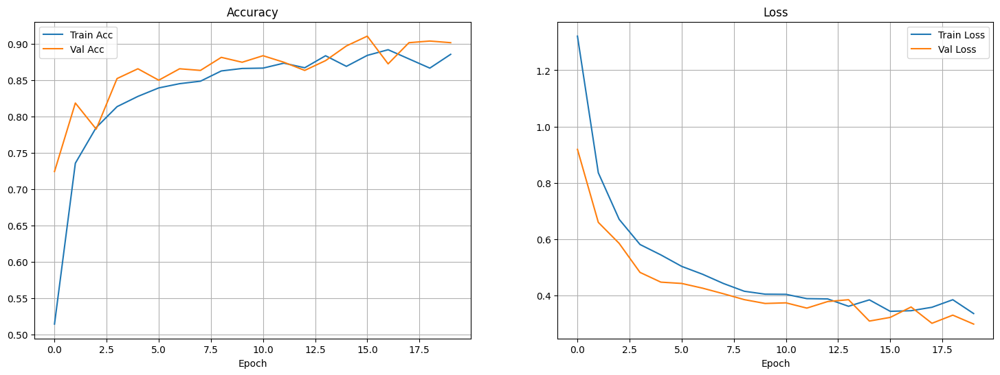

In [ ]:
def plot_history(history, model_name):
    fig, (ax1, ax2) = plt.subplots(1, 2, figsize=(18, 6))
    ax1.plot(history['train_acc'], label='Train Acc'); ax1.plot(history['val_acc'], label='Val Acc')
    ax1.set_title('Accuracy'); ax1.set_xlabel('Epoch'); ax1.legend(); ax1.grid(True)
    ax2.plot(history['train_loss'], label='Train Loss'); ax2.plot(history['val_loss'], label='Val Loss')
    ax2.set_title('Loss'); ax2.set_xlabel('Epoch'); ax2.legend(); ax2.grid(True)
    plt.show()
plot_history(history, " ")

                 precision    recall  f1-score   support

   missing_hole     1.0000    1.0000    1.0000        82
     mouse_bite     0.8163    0.9195    0.8649        87
   open_circuit     0.9538    0.8611    0.9051        72
          short     0.9180    0.8000    0.8550        70
           spur     0.7703    0.8382    0.8028        68
spurious_copper     0.8696    0.8571    0.8633        70

       accuracy                         0.8842       449
      macro avg     0.8880    0.8793    0.8818       449
   weighted avg     0.8891    0.8842    0.8848       449



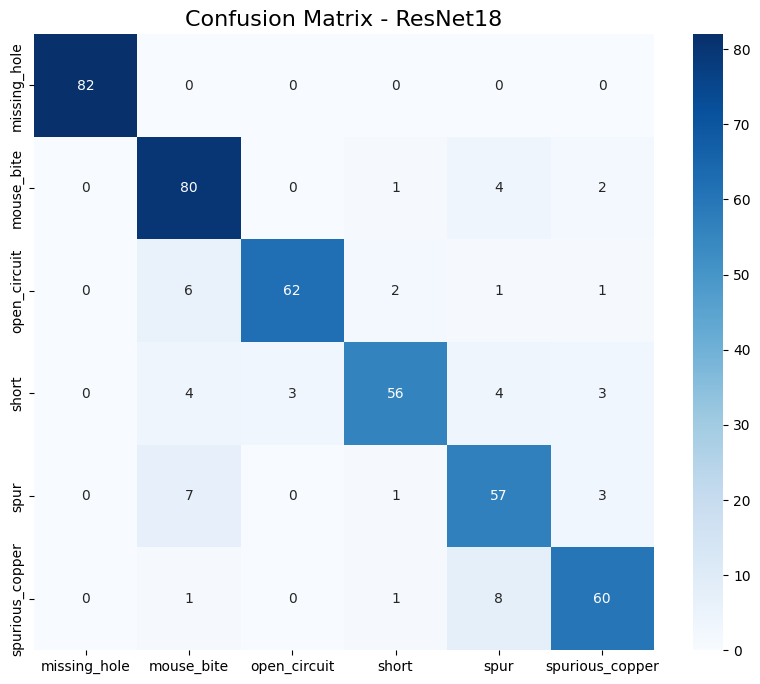

In [ ]:
def evaluate_model(model, dataloader, model_name):
    model.eval()
    y_true, y_pred = [], []
    with torch.no_grad():
        for inputs, labels in dataloader:
            outputs = model(inputs.to(device))
            _, predicted = torch.max(outputs, 1)
            y_true.extend(labels.numpy())
            y_pred.extend(predicted.cpu().numpy())
    print(classification_report(y_true, y_pred, target_names=class_names, digits=4))
    cm = confusion_matrix(y_true, y_pred)
    plt.figure(figsize=(10, 8))
    sns.heatmap(cm, annot=True, fmt='d', cmap='Blues', xticklabels=class_names, yticklabels=class_names)
    plt.title(f'Confusion Matrix - {model_name}', fontsize=16)
    plt.show()

evaluate_model(best_resnet_model, dataloaders['test'], "ResNet18")

# **End-to-end finetuning**

---



Model ResNet18 disiapkan untuk Full Fine-Tuning.
Epoch 1/15 | ----------
Train Loss: 1.6616 Acc: 0.3163
Val Loss: 1.5803 Acc: 0.3722
Validation loss improved (inf -> 1.5803). Saving model...

Epoch 2/15 | ----------
Train Loss: 1.3266 Acc: 0.5471
Val Loss: 1.3094 Acc: 0.5247
Validation loss improved (1.5803 -> 1.3094). Saving model...

Epoch 3/15 | ----------
Train Loss: 1.1163 Acc: 0.6871
Val Loss: 1.1142 Acc: 0.6480
Validation loss improved (1.3094 -> 1.1142). Saving model...

Epoch 4/15 | ----------
Train Loss: 0.9601 Acc: 0.7619
Val Loss: 0.9388 Acc: 0.7489
Validation loss improved (1.1142 -> 0.9388). Saving model...

Epoch 5/15 | ----------
Train Loss: 0.7982 Acc: 0.8226
Val Loss: 0.7824 Acc: 0.7982
Validation loss improved (0.9388 -> 0.7824). Saving model...

Epoch 6/15 | ----------
Train Loss: 0.6833 Acc: 0.8431
Val Loss: 0.6567 Acc: 0.8363
Validation loss improved (0.7824 -> 0.6567). Saving model...

Epoch 7/15 | ----------
Train Loss: 0.5727 Acc: 0.8829
Val Loss: 0.5445 Acc: 0

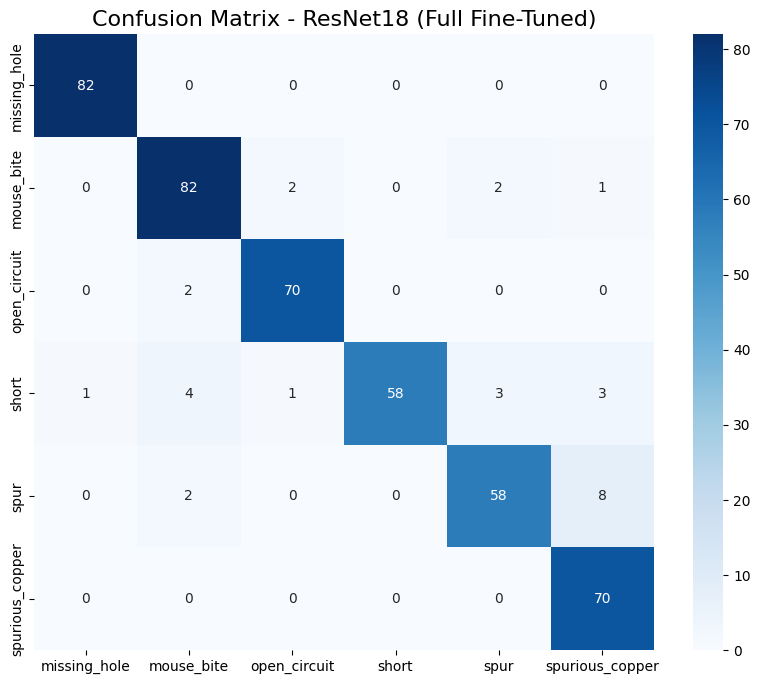

In [ ]:
full_finetune_model = models.resnet18(weights=models.ResNet18_Weights.IMAGENET1K_V1)

num_ftrs = full_finetune_model.fc.in_features
full_finetune_model.fc = nn.Linear(num_ftrs, num_classes)
full_finetune_model = full_finetune_model.to(device)

optimizer_full_finetune = optim.Adam([
    {'params': full_finetune_model.fc.parameters(), 'lr': 1e-4},
    {'params': [p for n, p in full_finetune_model.named_parameters() if 'fc' not in n], 'lr': 1e-6}
])

best_full_finetune_model, history_full_finetune = train_model(
    full_finetune_model,
    criterion,
    optimizer_full_finetune,
    num_epochs=15,
    patience=5
)

print("\n--- Evaluasi Model ResNet18 Full Fine-Tuned ---")
evaluate_model(best_full_finetune_model, dataloaders['test'], "ResNet18 (Full Fine-Tuned)")

ResNet (Feature Extract): Accuracy = 0.8842, F1-Score = 0.8848
ResNet (Fully-Tuned):      Accuracy = 0.9354, F1-Score = 0.9349


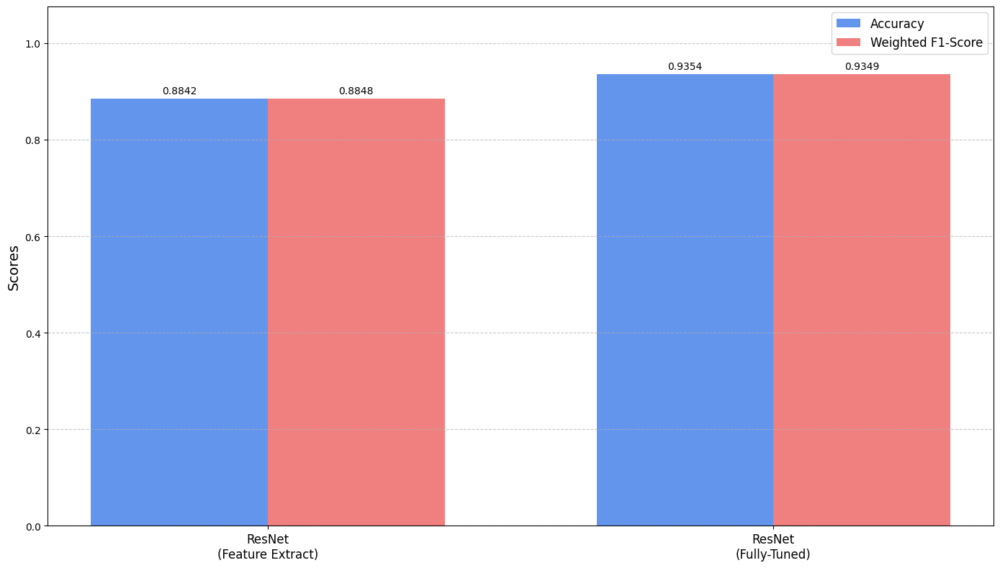

In [ ]:
def get_final_metrics(model, dataloader, device, class_names):
    model.eval()
    y_true = []
    y_pred = []
    with torch.no_grad():
        for inputs, labels in dataloader:
            if inputs.size(0) == 0:
                continue
            outputs = model(inputs.to(device))
            _, predicted = torch.max(outputs, 1)
            y_true.extend(labels.cpu().numpy())
            y_pred.extend(predicted.cpu().numpy())
    report = classification_report(y_true, y_pred, target_names=class_names, output_dict=True, zero_division=0)
    accuracy = report['accuracy']
    f1_score = report['weighted avg']['f1-score']
    return accuracy, f1_score
resnet_acc, resnet_f1 = get_final_metrics(best_resnet_model, dataloaders['test'], device, class_names)
tuned_acc, tuned_f1 = get_final_metrics(best_full_finetune_model, dataloaders['test'], device, class_names)

print(f"ResNet (Feature Extract): Accuracy = {resnet_acc:.4f}, F1-Score = {resnet_f1:.4f}")
print(f"ResNet (Fully-Tuned):      Accuracy = {tuned_acc:.4f}, F1-Score = {tuned_f1:.4f}")

model_labels = [
    'ResNet\n(Feature Extract)',
    'ResNet\n(Fully-Tuned)'
]

accuracies = [resnet_acc, tuned_acc]
f1_scores = [resnet_f1, tuned_f1]
x = np.arange(len(model_labels))
width = 0.35

fig, ax = plt.subplots(figsize=(14, 8))
rects1 = ax.bar(x - width/2, accuracies, width, label='Accuracy', color='cornflowerblue')
rects2 = ax.bar(x + width/2, f1_scores, width, label='Weighted F1-Score', color='lightcoral')
ax.set_ylabel('Scores', fontsize=14)
ax.set_xticks(x)
ax.set_xticklabels(model_labels, fontsize=12)
ax.legend(fontsize=12)
ax.grid(axis='y', linestyle='--', alpha=0.7)
ax.bar_label(rects1, padding=3, fmt='%.4f')
ax.bar_label(rects2, padding=3, fmt='%.4f')
ax.set_ylim(0, max(max(accuracies), max(f1_scores)) * 1.15)
fig.tight_layout()
plt.show()

# **Training Model (Custom CNN)**

---



Epoch 1/25 | ----------
Train Loss: 5.9825 Acc: 0.4859
Val Loss: 1.9962 Acc: 0.5426
Validation loss improved (inf -> 1.9962). Saving model...

Epoch 2/25 | ----------
Train Loss: 1.3241 Acc: 0.5428
Val Loss: 0.5881 Acc: 0.7511
Validation loss improved (1.9962 -> 0.5881). Saving model...

Epoch 3/25 | ----------
Train Loss: 1.0220 Acc: 0.5792
Val Loss: 0.5772 Acc: 0.7063
Validation loss improved (0.5881 -> 0.5772). Saving model...

Epoch 4/25 | ----------
Train Loss: 0.7991 Acc: 0.6419
Val Loss: 0.5640 Acc: 0.7668
Validation loss improved (0.5772 -> 0.5640). Saving model...

Epoch 5/25 | ----------
Train Loss: 0.8371 Acc: 0.6414
Val Loss: 0.5216 Acc: 0.7758
Validation loss improved (0.5640 -> 0.5216). Saving model...

Epoch 6/25 | ----------
Train Loss: 0.7803 Acc: 0.6672
Val Loss: 0.4085 Acc: 0.8498
Validation loss improved (0.5216 -> 0.4085). Saving model...

Epoch 7/25 | ----------
Train Loss: 0.7851 Acc: 0.6603
Val Loss: 0.3923 Acc: 0.8453
Validation loss improved (0.4085 -> 0.3923)

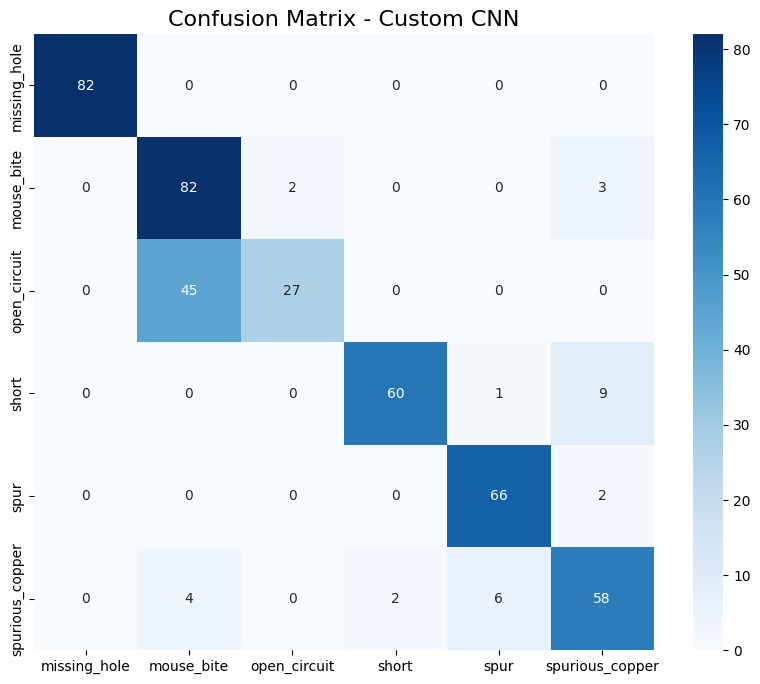

In [ ]:
import torch.nn as nn
import torch.nn.functional as F

class CustomCNN(nn.Module):
    def __init__(self, num_classes):
        super(CustomCNN, self).__init__()
        self.conv1 = nn.Conv2d(in_channels=3, out_channels=32, kernel_size=3, padding=1)
        self.bn1 = nn.BatchNorm2d(32)
        self.pool1 = nn.MaxPool2d(kernel_size=2, stride=2)
        self.conv2 = nn.Conv2d(in_channels=32, out_channels=64, kernel_size=3, padding=1)
        self.bn2 = nn.BatchNorm2d(64)
        self.pool2 = nn.MaxPool2d(kernel_size=2, stride=2)
        self.conv3 = nn.Conv2d(in_channels=64, out_channels=128, kernel_size=3, padding=1)
        self.bn3 = nn.BatchNorm2d(128)
        self.pool3 = nn.MaxPool2d(kernel_size=2, stride=2)
        with torch.no_grad():
            dummy_input = torch.zeros(1, 3, 224, 224)
            self.flattened_size = self._get_conv_output(dummy_input)

        self.fc1 = nn.Linear(self.flattened_size, 512)
        self.dropout = nn.Dropout(0.5)
        self.fc2 = nn.Linear(512, num_classes)

    def _get_conv_output(self, x):
        x = self.pool1(F.relu(self.bn1(self.conv1(x))))
        x = self.pool2(F.relu(self.bn2(self.conv2(x))))
        x = self.pool3(F.relu(self.bn3(self.conv3(x))))
        return x.view(x.size(0), -1).size(1)

    def forward(self, x):
        x = self.pool1(F.relu(self.bn1(self.conv1(x))))
        x = self.pool2(F.relu(self.bn2(self.conv2(x))))
        x = self.pool3(F.relu(self.bn3(self.conv3(x))))
        x = x.view(x.size(0), -1)
        x = F.relu(self.fc1(x))
        x = self.dropout(x)
        x = self.fc2(x)
        return x

criterion = nn.CrossEntropyLoss()
cnn_model = CustomCNN(num_classes=num_classes).to(device)
optimizer_cnn = optim.Adam(cnn_model.parameters(), lr=0.001)
best_cnn_model, history_cnn = train_model(
    cnn_model,
    criterion,
    optimizer_cnn,
    num_epochs=25,
    patience=7
)

print("\n--- Evaluasi Model Custom CNN ---")
evaluate_model(best_cnn_model, dataloaders['test'], "Custom CNN")


--- Mencoba Set Hyperparameter 1/1: {'lr': 0.0005, 'batch_size': 32, 'patience': 10} ---
Epoch 1/20 | ----------
Train Loss: 3.0404 Acc: 0.5680
Val Loss: 0.6768 Acc: 0.7623
Validation loss improved (inf -> 0.6768). Saving model...

Epoch 2/20 | ----------
Train Loss: 0.7907 Acc: 0.7055
Val Loss: 0.5577 Acc: 0.7175
Validation loss improved (0.6768 -> 0.5577). Saving model...

Epoch 3/20 | ----------
Train Loss: 0.6627 Acc: 0.7405
Val Loss: 0.4290 Acc: 0.8565
Validation loss improved (0.5577 -> 0.4290). Saving model...

Epoch 4/20 | ----------
Train Loss: 0.6217 Acc: 0.7585
Val Loss: 0.3124 Acc: 0.9036
Validation loss improved (0.4290 -> 0.3124). Saving model...

Epoch 5/20 | ----------
Train Loss: 0.5336 Acc: 0.7765
Val Loss: 0.3027 Acc: 0.8744
Validation loss improved (0.3124 -> 0.3027). Saving model...

Epoch 6/20 | ----------
Train Loss: 0.5242 Acc: 0.7828
Val Loss: 0.2916 Acc: 0.9148
Validation loss improved (0.3027 -> 0.2916). Saving model...

Epoch 7/20 | ----------
Train Loss: 0

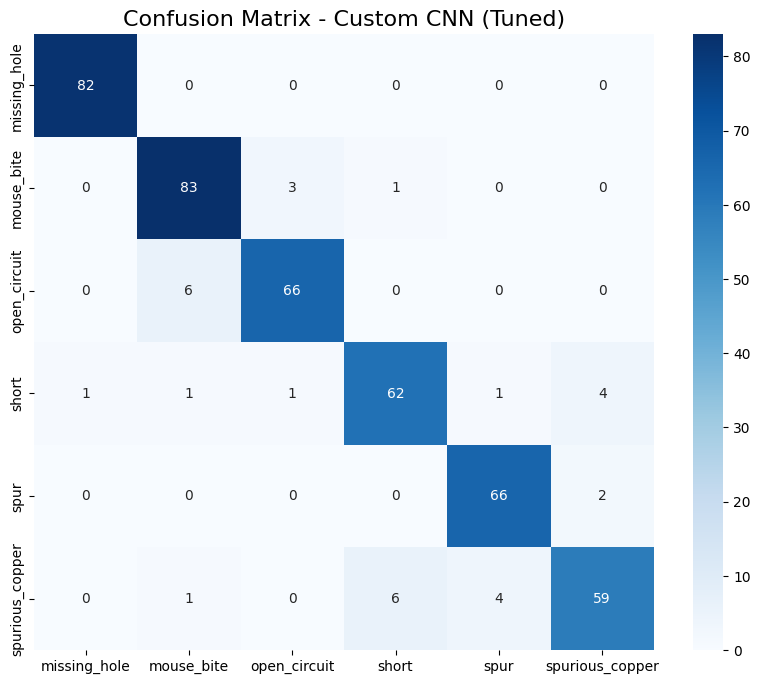

In [ ]:
tuning_params = [
    {'lr': 0.0005, 'batch_size': 32, 'patience': 10}
]
best_tuned_cnn_model = None
best_tuned_cnn_loss = float('inf')
best_params = None
tuning_histories = {}

for i, params in enumerate(tuning_params):
    print(f"\n--- Mencoba Set Hyperparameter {i+1}/{len(tuning_params)}: {params} ---")
    dataloaders_tuned = {
        'train': DataLoader(train_dataset, batch_size=params['batch_size'], shuffle=True, num_workers=os.cpu_count()),
        'val': DataLoader(val_dataset, batch_size=params['batch_size'], shuffle=False, num_workers=os.cpu_count()),
        'test': DataLoader(test_dataset, batch_size=params['batch_size'], shuffle=False, num_workers=os.cpu_count())
    }
    tuned_cnn_model = CustomCNN(num_classes=num_classes).to(device)
    optimizer_tuned_cnn = optim.Adam(tuned_cnn_model.parameters(), lr=params['lr'])

    tuned_model, history = train_model(
        tuned_cnn_model,
        criterion,
        optimizer_tuned_cnn,
        num_epochs=20,
        patience=params['patience']
    )

    tuning_histories[f'params_{i+1}'] = history
    final_val_loss = history['val_loss'][-1]
    print(f"Set Hyperparameter {i+1} Selesai. Final Validation Loss: {final_val_loss:.4f}")
    if final_val_loss < best_tuned_cnn_loss:
        print(f"Validation loss improved ({best_tuned_cnn_loss:.4f} -> {final_val_loss:.4f}). Menyimpan model terbaik...")
        best_tuned_cnn_loss = final_val_loss
        best_tuned_cnn_model = copy.deepcopy(tuned_model.state_dict())
        best_params = params

print("\n--- Tuning Custom CNN Selesai ---")
print(f"Hyperparameter Terbaik: {best_params}")
print(f"Validation Loss Terbaik: {best_tuned_cnn_loss:.4f}")


final_cnn_model = CustomCNN(num_classes=num_classes).to(device)
final_cnn_model.load_state_dict(best_tuned_cnn_model)
print("\n--- Evaluasi Model Custom CNN Terbaik pada Test Set ---")
evaluate_model(final_cnn_model, dataloaders['test'], "Custom CNN (Tuned)")

# **Saving and Loading Model**

---



In [ ]:
import pickle
nama_file_model = 'model_defect_detection.pkl'
with open(nama_file_model, 'wb') as file:
    pickle.dump(best_full_finetune_model, file)

print(f"Model telah disimpan ke file: {nama_file_model}")

Model telah disimpan ke file: model_defect_detection.pkl


In [ ]:
with open('model_defect_detection.pkl', 'rb') as file:
    loaded_model = pickle.load(file)
print(f"Model berhasil dimuat dari file: {nama_file_model}")

Model berhasil dimuat dari file: model_defect_detection.pkl
